# 0. 목차

1. **EDA 및 데이터 전처리 전략 설계**   
   - 1.1 샘플 이미지 확인   
   - 1.2 이미지 유사도 확인
   - 1.3 클래스 별 이미지 수 확인   
   - 1.4 중복 이미지 탐지   
   - 1.5 이미지 품질 확인   
   - 1.6 EDA 결론 및 전처리 전략 설계

</n>

2. **데이터 전처리**   
   - 2.1 배경 제거   
   - 2.2 blue jellyfish 데이터셋에서 moon jellyfish 골라내기   
   - 2.3 한 이미지 내 중복 개체가 있는 경우 제거  

</n>

3. **Baseline 모델 설계**
    - 3.0 모델 톺아보기 및 베이스라인 모델 선택
    - 3.1 베이스라인 모델 성능 검증
    - 3.2 베이스라인 모델로 전처리 데이터 성능 검증 
        - 3.2.1 배경제거 데이터 성능 검증
        - 3.2.2 중복개체 제거 데이터 성능 검증
    - 3.3 최종 전처리 데이터 생성

</n>

4. **모델 성능 개선**
    - 4.1 여러 모델 테스트
        - 4.1.1 CNN
        - 4.1.2 mobilenet v2
        - 4.1.3 ConvNext
        - 4.1.4 Resnet50

</n>

5. **결론 및 한계점**

## 초기 세팅

In [ ]:
#필요한 패키지 다운

!pip install wandb==0.16.0
!pip install opencv-python
!pip install ImageHash Pillow
!pip install rembg
!pip install onnxruntime
!pip install albumentations
!pip install scikit-image opencv-python tqdm seaborn
!pip install --upgrade numpy==1.20.0

In [2]:
#필요한 모듈 임포트
from tensorflow.keras import layers, models
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import seaborn as sns
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import train_test_split
import wandb
from wandb.keras import WandbCallback
from sklearn.preprocessing import LabelEncoder
from PIL import Image, ImageEnhance, ImageOps
import glob
import os
import matplotlib.pyplot as plt
import random
import cv2
import numpy as np
from pathlib import Path
import hashlib
import imagehash
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, save_img
from tqdm import tqdm
from rembg import remove
import io
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances, cosine_similarity
from sklearn.cluster import KMeans
from skimage.feature import hog
from tensorflow.keras import layers, models, Model
from tensorflow.keras.applications import MobileNetV3Large, MobileNetV2
from tensorflow.keras.callbacks import ReduceLROnPlateau 
from tensorflow.keras.optimizers import Adam, RMSprop
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report
import shutil
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import load_img, img_to_array, save_img
from tensorflow.keras.applications import MobileNetV2
import albumentations as A
from skimage.feature import local_binary_pattern
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.transform import resize
from scipy.spatial.distance import euclidean
from collections import defaultdict
from tensorflow.keras.callbacks import ModelCheckpoint
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torchvision.models import convnext_tiny, ConvNeXt_Tiny_Weights
from torchvision import transforms
from torchvision.models import ResNet50_Weights
from torchvision import models

C:\Users\kimho\anaconda3\Lib\site-packages\paramiko\pkey.py:82: CryptographyDeprecationWarning: TripleDES has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.TripleDES and will be removed from this module in 48.0.0.
  "cipher": algorithms.TripleDES,
C:\Users\kimho\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.Blowfish and will be removed from this module in 45.0.0.
  "class": algorithms.Blowfish,
C:\Users\kimho\anaconda3\Lib\site-packages\paramiko\transport.py:243: CryptographyDeprecationWarning: TripleDES has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.TripleDES and will be removed from this module in 48.0.0.
  "class": algorithms.TripleDES,


In [140]:
#통합 작업을 위한 경로 취합

#top_path
if os.path.exists("/aiffel/aiffel/jellyfish"):
    top_path = "/aiffel/aiffel/jellyfish"
elif os.path.exists("C:/Users/kimho/Dlthon_c1"):
    top_path = "C:/Users/kimho/Dlthon_c1"
elif os.path.exists("/root/aiffel/jellyfish"):
    top_path = "/root/aiffel/jellyfish"

#base_path(Train_Test_valid 폴더)
if os.path.exists("/aiffel/aiffel/jellyfish/Train_Test_Valid"):
    base_path = "/aiffel/aiffel/jellyfish/Train_Test_Valid"
elif os.path.exists("C:/Users/kimho/Dlthon_c1/Train_Test_Valid"):
    base_path = "C:/Users/kimho/Dlthon_c1/Train_Test_Valid"
elif os.path.exists("/root/aiffel/jellyfish/Train_Test_Valid"):
    base_path = "/root/aiffel/jellyfish/Train_Test_Valid"

train_path = os.path.join(base_path, "Train")
valid_path = os.path.join(base_path, "valid")
test_path = os.path.join(base_path, "test")

----
# 1. EDA 및 데이터 전처리 전략 설계

## 1.0 시도한 EDA 목록

1. **샘플 이미지** 확인
      - 해파리 외의 미칠 다른 요소들이 있는가? (배경 등...)
      - 특정 무늬나 형태로 구분할 수 있는 해파리가 있는가?
      - 색깔로 구분할 수 있는 해파리가 있는가?
      - 하나의 사진에 해파리가 여러마리 들어있는 경우가 있는가?

</n>

2. 이미지 **유사도** 확인
      - 다른 종이지만 비슷하게 생긴 해파리가 있는가?

</n>

3. 클래스 별 **이미지 수** 확인   
      - 클래스 간 imbalance 가능성 확인

</n>

4. **중복** 이미지 탐지

</n>

5. 이미지 **품질** 확인
      - 흐리거나 노이즈가 있는 이미지가 있는가?

## 1.1 샘플 이미지 확인



### 1.1.1 내용 요약

**[확인 사항]**
  - 해파리 외의 미칠 다른 요소들이 있는가? (배경 등...)
  - 특정 무늬나 형태로 구분할 수 있는 해파리가 있는가?
  - 색깔로 구분할 수 있는 해파리가 있는가?
  - 하나의 사진에 해파리가 여러마리 들어있는 경우가 있는가?


**[과정]**
1. 각 클래스 별 Train 이미지 20장씩 출력해보고, 해파리 외의 영향을 미칠 다른 요소 있는지 파악 시도. (배경 등)   
2. Moon_jellyfish의 배경색이 파란색일 때 blue_jellyfish와 비슷해 보임.
3. Moon_jellyfish와 blue_jellyfish 각 샘플 이미지 50장을 출력하여 유사 정도 파악 시도.
4. 발견 사항   
  1) 샘플 중 이미 증강 처리 된 데이터가 있음을 확인   
  2) blue_jellyfish 샘플 속 moon_jellyfish로 보이는 샘플 다수 발견

### 1.1.2 각 클래스 별 Train 이미지 출력

#### 1) barrel_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "barrel_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 20장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 2) blue_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "blue_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 3) compass_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "compass_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 4) lions_mane_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "lions_mane_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 5) mauve_stinger_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "mauve_stinger_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

#### 6) Moon_jellyfish

In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "Moon_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 5장 선택
sample_images = random.sample(os.listdir(class_path), 20)

# 시각화
plt.figure(figsize=(20, 10))  # 사이즈도 키우기
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(4, 5, i+1)  # 4행 5열
    plt.imshow(img)
    plt.title(sample_class.replace("_", " ").title())
    plt.axis("off")
plt.tight_layout()
plt.show()

### 1.1.3 blue & Moon 비슷하여 샘플 50장 출력하여 비교하기

**why?**
- Moon_jellyfish의 배경색이 파란색일 때 blue_jellyfish와 비슷해 보임
- Moon_jellyfish와 blue_jellyfish 각 샘플 이미지 50장을 출력하여 유사 정도 파악 시도


In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "blue_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 50장 선택 (에러 방지용 min 사용)
image_files = os.listdir(class_path)
num_images = min(50, len(image_files))
sample_images = random.sample(image_files, num_images)

# 시각화 (5행 10열)
plt.figure(figsize=(25, 13))
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(5, 10, i+1)
    plt.imshow(img)
    plt.title(f"{i+1}", fontsize=8)
    plt.axis("off")
plt.tight_layout()
plt.show()


In [ ]:
# 해파리 클래스 중 하나 선택
sample_class = "Moon_jellyfish"
class_path = os.path.join(train_path, sample_class)

# 파일 목록에서 무작위로 50장 선택 (에러 방지용 min 사용)
image_files = os.listdir(class_path)
num_images = min(50, len(image_files))
sample_images = random.sample(image_files, num_images)

# 시각화 (5행 10열)
plt.figure(figsize=(25, 13))
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(class_path, img_name)
    img = Image.open(img_path)
    plt.subplot(5, 10, i+1)
    plt.imshow(img)
    plt.title(f"{i+1}", fontsize=8)
    plt.axis("off")
plt.tight_layout()
plt.show()


### 1.1.4 결론

1.   
- **확인 사항:** 해파리 외 판별에 영향을 미칠 다른 요소들이 있는가?
- **결론:** 배경색이 가지각색이라 판별에 영향을 미칠 수 있을 것으로 판단됨
- **대응 전략:** Grad-CAM을 통해서 판별이 가능할 것이나,    
Moon과 Blue jellyfish 를 제외한 모든 해파리는 고유의 색을 가지고 있기 때문에    
선제적으로 대응할 필요는 없을 것으로 보인다.   
추후 추가적인 정확도 향상이 필요할 시 적용 예정.


2.   
- **확인 사항:** 특정 무늬나 형태로 구분할 수 있는 해파리가 있는가?
- **결론:** 모든 해파리는 고유한 형태와 패턴을 가지고있어 판별에 사용할 수 있다.
- **대응 전략:** 텍스처 시각화로 정확도를 높인다.

3.
- **확인 사항:** 색깔로 구분할 수 있는 해파리가 있는가?
- **결론:** 모든 해파리는 고유의 색깔을 가지고 있으나, 이미지의 빛 정도 등에 따라 색상의 왜곡이 있어 판별에 사용하기는 어렵다.
- **대응 전략:** X

4.
- **확인 사항:** 하나의 사진에 해파리가 여러마리 들어있는 경우가 있는가?
- **결론:** 있다.
- **대응 전략:** 하지만 이것이 판별에 영향을 미치는지는 따져볼 필요가 있음.
  - 논문 Deep Learning for Computer Vision (Adrian Rosebrock, PyImageSearch) 및 Stanford CS231n (Fei-Fei Li et al.) – Lecture Notes에 의거하면,   
   **하나의 이미지에 동일 종 해파리가 여러 마리 있어도, 선명하고 명확하면 문제 없음.   
  다만 겹쳐 있거나 중심이 애매한 경우는 노이즈가 됨.**
  - **추후 정확도를 올릴 필요가 있다면, GradCAM을 통해 학습된 모델이 집중하는 부분을 확인 후 대응**

5.
- **추가 확인 사항:** 샘플 중 이미 증강 처리 된 데이터가 있음을 확인
- **대응 전략:** 증강 및 미증강 이미지 수를 확인하고, 데이터 수를 본 후 판단

6.    
- **추가 확인 사항:** blue_jellyfish 샘플 속 moon_jellyfish로 보이는 샘플 다수 발견
- **대응 전략:**    
    1) moon jellyfish를 먼저 학습시킨다.   
    2) blue jellyfish 샘플 중 moon jellyfish로 판별되는 이미지 샘플을 추출하여 제거한다.   
    3) 남은 blue jellyfish 이미지 셋만을 가지고 학습시킨다. (추가 증강 필요)

---

## 1.2 이미지 유사도 확인

### 1.2.1 내용 요약


**[확인 사항]**
- 다른 종이지만 비슷하게 생긴 해파리 확인


**[과정]**
1. **색상** 유사도 확인
    1) 각 이미지의 배경 제거
    2) 클래스 별 3가지 dominant color 추출
    3) 클래스 간 평균 대표 색상끼리 거리(Euclidean) 계산
    4) 유사도 시각화 & 분석

</n>

2. **형태** 유사도 확인
   1) 각 이미지의 배경 제거
   2) 이미지 resize & 흑백으로 변환(grayscale)
   3) HOG descriptor 추출
   4) 클래스 당 여러 이미지 -> 평균 HOG 벡터 생성
   5) 클래스 간 cosine 유사도 계산
   6) 유사도 시각화 & 분석

</n>

3. **텍스처** 유사도 확인
   1) LBP(Local Binary Pattern) 히스토그램 추출
   2) 클래스 별 평균 LBP 히스토그램 생성
   3) 클래스 간 유사도 계산 (Euclidean Distance)
   4) 유사도 시각화 & 분석

### 1.2.2 색상 유사도 확인

In [138]:
classes = [
    "barrel_jellyfish",
    "blue_jellyfish",
    "compass_jellyfish",
    "lions_mane_jellyfish",
    "mauve_stinger_jellyfish",
    "Moon_jellyfish"
]

# 배경 제거 함수
def remove_background_cv2(cv_img):
    pil_img = Image.fromarray(cv2.cvtColor(cv_img, cv2.COLOR_BGR2RGB))
    output = remove(pil_img)
    return cv2.cvtColor(np.array(output), cv2.COLOR_RGBA2RGB)


# dominant color 추출 (대표 색상 3개)
def get_dominant_colors(img, k=3):
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    pixels = img_rgb.reshape(-1, 3)
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    kmeans.fit(pixels)
    return kmeans.cluster_centers_  # (k, 3)

def get_class_representative_color(class_dir, max_images=15, k=3):
    files = [f for f in os.listdir(class_dir) if f.endswith(".jpg") and "aug" not in f]
    dom_colors = []
    for f in tqdm(files[:max_images], desc=os.path.basename(class_dir)):
        img_path = os.path.join(class_dir, f)
        img = cv2.imread(img_path)
        if img is None:
            continue
        try:
            img_nobg = remove_background_cv2(img)
            doms = get_dominant_colors(img_nobg, k=k)
            dom_colors.extend(doms)
        except:
            print(f"⚠️ 배경 제거 실패: {f}")
    if dom_colors:
        return np.mean(dom_colors, axis=0)  # (3,) RGB 평균
    else:
        return np.array([0, 0, 0])  # fallback

Moon_jellyfish: 100%|████████████████████████████████████████████████████████████████████████| 15/15 [00:31<00:00,  2.09s/it]


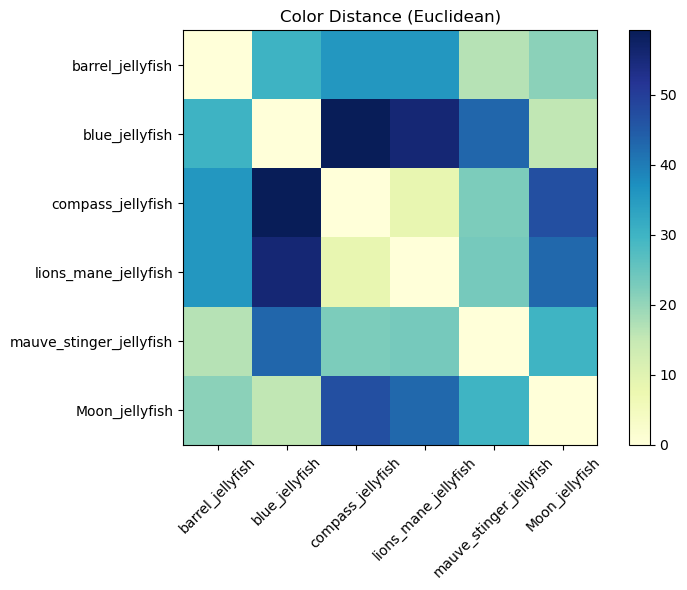


🎨 대표 색상 유사도가 가장 가까운 클래스 TOP 5 (Euclidean 거리):
compass_jellyfish ↔ lions_mane_jellyfish : 거리 = 8.44
blue_jellyfish ↔ Moon_jellyfish : 거리 = 15.29
barrel_jellyfish ↔ mauve_stinger_jellyfish : 거리 = 16.51
barrel_jellyfish ↔ Moon_jellyfish : 거리 = 20.95
compass_jellyfish ↔ mauve_stinger_jellyfish : 거리 = 22.58


In [139]:
# 유사도 분석 및 시각화
def show_similarity_matrix(dist_matrix, labels, title="Color Distance (Euclidean)"):
    plt.figure(figsize=(8, 6))
    plt.imshow(dist_matrix, cmap="YlGnBu")
    plt.title(title)
    plt.colorbar()
    plt.xticks(ticks=np.arange(len(labels)), labels=labels, rotation=45)
    plt.yticks(ticks=np.arange(len(labels)), labels=labels)
    plt.tight_layout()
    plt.show()

def print_most_similar(dist_matrix, labels, top_k=5):
    pairs = []
    for i in range(len(labels)):
        for j in range(i + 1, len(labels)):
            dist = dist_matrix[i, j]
            pairs.append((labels[i], labels[j], dist))
    sorted_pairs = sorted(pairs, key=lambda x: x[2])
    print(f"\n🎨 대표 색상 유사도가 가장 가까운 클래스 TOP {top_k} (Euclidean 거리):")
    for a, b, d in sorted_pairs[:top_k]:
        print(f"{a} ↔ {b} : 거리 = {d:.2f}")

# 실행
if __name__ == "__main__":
    representative_colors = {}
    for cls in classes:
        class_dir = os.path.join(train_path, cls)
        rep_color = get_class_representative_color(class_dir, max_images=15, k=3)
        representative_colors[cls] = rep_color

    labels = list(representative_colors.keys())
    color_matrix = np.array([representative_colors[cls] for cls in labels])
    dist_matrix = euclidean_distances(color_matrix)

    show_similarity_matrix(dist_matrix, labels)
    print_most_similar(dist_matrix, labels)

**[색상 유사도 결론]**

1.    
- **발견 사항:** compass <-> lions_mane (거리 8.44): 매우 유사함.   
- **대응 전략:** 전처리나 모델 설계에서 형태 강조 필요  

2.   
- **발견 사항:** 유사도 15~25 사이의 유사한 색상 그룹 다수
- **대응 전략:** 모델이 형태에 집중하도록 해야할지 판단 필요

### 1.2.3 형태 유사도 확인

In [142]:
# HOG descriptor 추출
def extract_HOG_features(img, resize=(128, 128)):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    resized = cv2.resize(gray, resize)
    features = hog(resized, orientations=9, pixels_per_cell=(8, 8),
                   cells_per_block=(2, 2), block_norm='L2-Hys', visualize=False)
    return features  # 1D 벡터


#평균 HOG 벡터 생성
def get_class_HOG_average(class_dir, max_images=15):
    files = [f for f in os.listdir(class_dir) if f.endswith(".jpg") and "aug" not in f]
    hogs = []
    for f in tqdm(files[:max_images], desc=os.path.basename(class_dir)):
        img_path = os.path.join(class_dir, f)
        img = cv2.imread(img_path)
        if img is None:
            continue
        try:
            img_nobg = remove_background_cv2(img)
            feat = extract_HOG_features(img_nobg)
            hogs.append(feat)
        except:
            print(f"⚠️ 처리 실패: {f}")
    if hogs:
        return np.mean(hogs, axis=0)
    else:
        return np.zeros((8100,))  # 기본 크기 (128x128 기준)

Moon_jellyfish: 100%|████████████████████████████████████████████████████████████████████████| 15/15 [00:28<00:00,  1.88s/it]


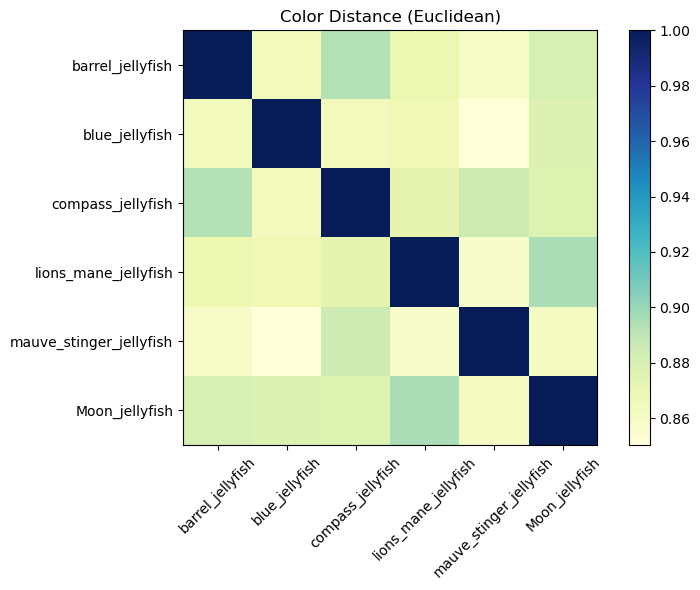


🧱 형태 기반 유사도가 높은 클래스 TOP 5:
lions_mane_jellyfish ↔ Moon_jellyfish : 유사도 = 0.8953
barrel_jellyfish ↔ compass_jellyfish : 유사도 = 0.8925
compass_jellyfish ↔ mauve_stinger_jellyfish : 유사도 = 0.8848
barrel_jellyfish ↔ Moon_jellyfish : 유사도 = 0.8807
blue_jellyfish ↔ Moon_jellyfish : 유사도 = 0.8777


In [143]:
def print_top_similar_pairs(sim_matrix, labels, top_k=5):
    pairs = []
    for i in range(len(labels)):
        for j in range(i + 1, len(labels)):
            sim = sim_matrix[i, j]
            pairs.append((labels[i], labels[j], sim))
    sorted_pairs = sorted(pairs, key=lambda x: -x[2])
    print(f"\n🧱 형태 기반 유사도가 높은 클래스 TOP {top_k}:")
    for a, b, score in sorted_pairs[:top_k]:
        print(f"{a} ↔ {b} : 유사도 = {score:.4f}")

# -----------------------------
# 실행
# -----------------------------
if __name__ == "__main__":
    hog_features = {}
    for cls in classes:
        class_dir = os.path.join(train_path, cls)
        hog_features[cls] = get_class_HOG_average(class_dir, max_images=15)

    labels = list(hog_features.keys())
    hog_matrix = np.array([hog_features[cls] for cls in labels])
    sim_matrix = cosine_similarity(hog_matrix)

    show_similarity_matrix(sim_matrix, labels)
    print_top_similar_pairs(sim_matrix, labels)

**[형태 유사도 결론]**

- **발견 사항:** Moon_jellyfish가 5개 중 3개의 쌍에서 나타남   
- **대응 전략:** 분리 학습 또는 샘플 강조 등 별도 처리 필요  

### 1.2.4 텍스처 유사도 확인

클래스별 LBP 계산:   0%|                                                                               | 0/6 [00:00<?, ?it/s]C:\Users\kimho\anaconda3\Lib\site-packages\skimage\feature\texture.py:360: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(
클래스별 LBP 계산: 100%|███████████████████████████████████████████████████████████████████████| 6/6 [00:05<00:00,  1.11it/s]


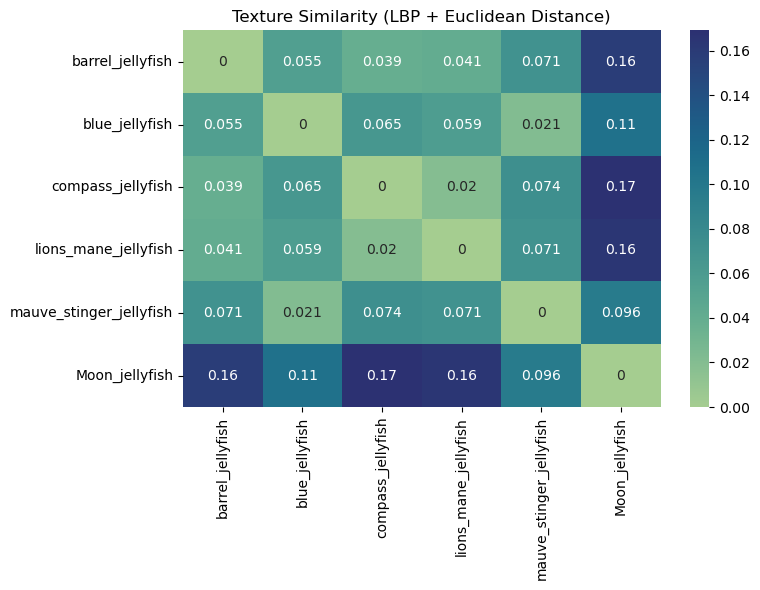

In [146]:
# LBP 설정
LBP_RADIUS = 1
LBP_POINTS = 8 * LBP_RADIUS
LBP_METHOD = 'uniform'

# 클래스 목록
class_names = [
    "barrel_jellyfish",
    "blue_jellyfish",
    "compass_jellyfish",
    "lions_mane_jellyfish",
    "mauve_stinger_jellyfish",
    "Moon_jellyfish"
]

# 이미지 경로 설정
BASE_DIR = "C:/Users/kimho/Dlthon_c1"
IMG_SIZE = (224, 224)

# 클래스별 평균 LBP 히스토그램 계산
def compute_avg_lbp_histograms(base_dir, class_names):
    histograms = {}

    for cls in tqdm(class_names, desc="클래스별 LBP 계산"):
        folder_path = os.path.join(base_dir, cls)
        files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png')) and 'aug' not in f]

        lbp_hist_list = []

        for fname in files[:30]:  # 너무 오래 걸리므로 각 클래스당 최대 30장 사용
            img_path = os.path.join(folder_path, fname)
            img = imread(img_path)
            gray = rgb2gray(resize(img, IMG_SIZE))

            lbp = local_binary_pattern(gray, P=LBP_POINTS, R=LBP_RADIUS, method=LBP_METHOD)
            (hist, _) = np.histogram(lbp.ravel(), bins=np.arange(0, LBP_POINTS + 3), range=(0, LBP_POINTS + 2))
            hist = hist.astype("float")
            hist /= (hist.sum() + 1e-6)

            lbp_hist_list.append(hist)

        avg_hist = np.mean(lbp_hist_list, axis=0)
        histograms[cls] = avg_hist

    return histograms

# 클래스 간 유사도(거리) 계산
def compute_texture_similarity(histograms):
    classes = list(histograms.keys())
    n = len(classes)
    distance_matrix = np.zeros((n, n))

    for i in range(n):
        for j in range(n):
            distance_matrix[i, j] = euclidean(histograms[classes[i]], histograms[classes[j]])

    return classes, distance_matrix

# 시각화
def plot_texture_similarity(classes, distance_matrix):
    plt.figure(figsize=(8, 6))
    sns.heatmap(distance_matrix, xticklabels=classes, yticklabels=classes, annot=True, cmap='crest')
    plt.title("Texture Similarity (LBP + Euclidean Distance)")
    plt.tight_layout()
    plt.show()

# 실행
histograms = compute_avg_lbp_histograms(BASE_DIR, class_names)
classes, dist_matrix = compute_texture_similarity(histograms)
plot_texture_similarity(classes, dist_matrix)

**[텍스처 유사도 결론]**

- **발견 사항:**
    - 유클리디안 거리 값이 전반적으로 **매우 낮은 수준 (0.02~0.17)**임
    - 다른 클래스 대비 Moon_jellyfish는 확연히 큰 거리를 보임

</n>

- **대응 전략:**
    - 해파리의 실제 텍스처 패턴(무늬나 선명도)은 배경에 의해 희석되거나 가려질 수 있으므로,   
      **배경 제거**가 필요할 것임
    - Blue_jellyfish 내에 Moon_jellyfish 샘플이 섞여있어   
      모델이 이 두 종을 텍스처 특성 기반으로 혼동할 수 있음.   
      따라서 **Blue_jellyfish 내에서 Moon_jellyfish를 솎아내야 함.**

### 1.2.5 결론

이미지 색상 모두 유사 (모두 euclide distance 50 이하)   
이미지 형태 모두 유사 (모두 85% 이상)   
이미지 텍스처 전반적으로 유사하나, Moon_jellyfish 튐.

따라서 아래 전처리 전략 차용   
- 배경 제거   
- Blue_jellyfish 내에서 Moon_jellyfish를 솎아내기   

----

## 1.3 클래스 별 이미지 수 확인

**[확인 사항]**
  - 클래스 간 이미지 셋의 수를 확인하여 imbalance 확인

                     Class  Total  Original  Augmented
0         barrel_jellyfish    150        41        109
1           blue_jellyfish    150        55         95
2        compass_jellyfish    150        57         93
3     lions_mane_jellyfish    150        61         89
4  mauve_stinger_jellyfish    150        58         92
5           Moon_jellyfish    150        47        103


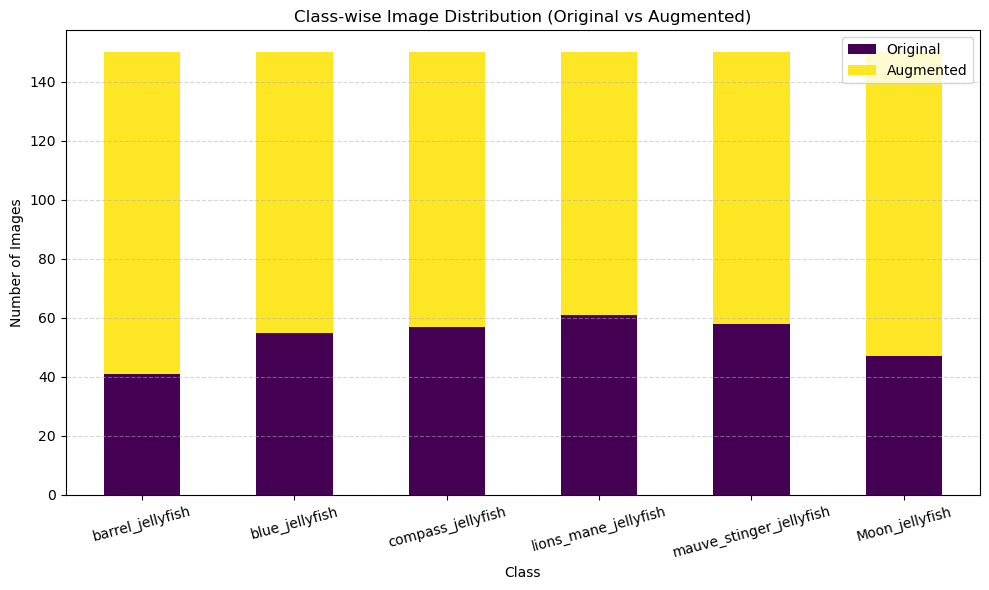

In [152]:
# 이미지 확장자 정의
valid_exts = [".jpg", ".jpeg", ".png"]

# 무시할 폴더
exclude_folders = ['.ipynb_checkpoints', 'Train_Test_Valid']

# 결과 저장용 리스트
class_stats = []

# 클래스별 루프
for class_folder in os.listdir(train_path):
    if class_folder in exclude_folders or not os.path.isdir(os.path.join(train_path, class_folder)):
        continue

    class_path = os.path.join(train_path, class_folder)
    all_files = os.listdir(class_path)

    image_files = [f for f in all_files if os.path.splitext(f)[-1].lower() in valid_exts]
    aug_images = [f for f in image_files if "aug" in f.lower()]
    orig_images = [f for f in image_files if "aug" not in f.lower()]

    class_stats.append({
        "Class": class_folder,
        "Total": len(image_files),
        "Original": len(orig_images),
        "Augmented": len(aug_images)
    })

# DataFrame으로 출력
df_stats = pd.DataFrame(class_stats)
print(df_stats)

# 시각화 (원본 + 증강)
df_stats.set_index("Class")[["Original", "Augmented"]].plot(kind="bar", stacked=True, figsize=(10,6), colormap="viridis")
plt.title("Class-wise Image Distribution (Original vs Augmented)")
plt.ylabel("Number of Images")
plt.xticks(rotation=15)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

### 1.3.1 결론


**확인 사항:** 클래스 별 이미지 수의 imbalance가 존재하는가?   
**결론:**
- 약한 불균형은 존재하지만, 문제 될 정도는 아님.
  - 가장 원본이 적은 클래스는 41장 (27%)
  - 가장 원본이 많은 클래스는 61장 (40%)

**대응 전략:** 큰 문제 없으나, 필요 시 early stopping, val set 기준 평가, mixup 등으로 커버 가능

---
## 1.4 중복 이미지 탐지

### 1.4.1 내용 요약

**[확인 사항]**   
**1. 완전 동일한 이미지 탐지 :** 바이트 해시 (MD5)를 통해 이미지 내용을 바이트 단위로 읽고 hash를 계산해서 비교   
**2. 유사 이미지 탐지 :** Perceptual Hash에서 imagehash 라이브러리를 사용해서 비슷한 이미지를 탐지

**[결과]**
- 완전 중복 이미지 x
- 유사한 이미지 o(66쌍)

### 1.4.2 완전 동일한 이미지 유무 확인
- 완전히 똑같은 이미지는 없음.

In [158]:
def get_file_hash(file_path):
    with open(file_path, "rb") as f:
        return hashlib.md5(f.read()).hexdigest()

hash_dict = {}
dup_files = []

for root, _, files in os.walk(base_path):
    for file in files:
        path = os.path.join(root, file)
        if os.path.splitext(file)[-1].lower() in [".jpg", ".jpeg", ".png"]:  # 이미지 파일만
            file_hash = get_file_hash(path)
            if file_hash in hash_dict:
                dup_files.append((path, hash_dict[file_hash]))
            else:
                hash_dict[file_hash] = path

print(f"완전히 동일한 이미지 수: {len(dup_files)}")
for dup in dup_files:  # 전체 출력
    print(f"중복쌍:\n  {dup[0]}\n  {dup[1]}\n")

완전히 동일한 이미지 수: 220
중복쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\blue_jellyfish\02.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\notmoon\02.jpg

중복쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\blue_jellyfish\03.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\notmoon\03.jpg

중복쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\blue_jellyfish\04.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\notmoon\04.jpg

중복쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\blue_jellyfish\06.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\notmoon\06.jpg

중복쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\blue_jellyfish\07.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\notmoon\07.jpg

중복쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\blue_jellyfish\08.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\notmoon\08.jpg

중복쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\Train\blue_jellyfish

### 1.4.3 유사한 이미지 있는지 확인
- 66쌍 존재하는 것을 확인함.(유사하는 쌍을 찾도록 함, 증강된 데이터셋이라 유사한 이미지가 2개 아니라, 3개일 수도...? 필요시 추가 확인)
- 쌍으로 페어된 이미지를 나란히 출력하여 확인함.

In [160]:
phash_dict = {}
similar_imgs = []

for root, _, files in os.walk(base_path):
    for file in files:
        path = os.path.join(root, file)
        try:
            if os.path.splitext(file)[-1].lower() in [".jpg", ".jpeg", ".png"]:
                img = Image.open(path).convert("RGB").resize((256, 256))
                phash = imagehash.phash(img)
                if phash in phash_dict:
                    similar_imgs.append((path, phash_dict[phash]))
                else:
                    phash_dict[phash] = path
        except Exception as e:
            print(f"불러오기 실패: {path} ({e})")
            continue

print(f"유사 이미지로 감지된 쌍 수: {len(similar_imgs)}")
for sim in similar_imgs[:5]:
    print(f"유사쌍:\n  {sim[0]}\n  {sim[1]}\n")


유사 이미지로 감지된 쌍 수: 286
유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\35.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\12.jpg

유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\37.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\22.jpg

유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\43.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\30.jpg

유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\47.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\32.jpg

유사쌍:
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\49.jpg
  C:/Users/kimho/Dlthon_c1/Train_Test_Valid\moon_clean_tmp\moon\34.jpg



#### 유사한 이미지 쌍 출력해보기
- 비슷하다고 판단된 이미지는 약한 데이터 증강으로 추측.
- 유사한 이미지가 학습에 유용할지 방해될지 판단 필요할 수 있음.
- 삭제하거나 병합하면 샘플 수가 줄어든다는 문제 발생.   
 -> 추후 필요하다면, 약한 증강 이미지 삭제 후 샘플 수를 맞춰 재증강 예정

In [ ]:
# 앞에서 감지된 유사 이미지 쌍 리스트: similar_imgs
# 시각화 개수 설정 (예: 10쌍)
num_to_display = min(30, len(similar_imgs)) # 수를 수정하여 출력 쌍의 개수를 조절 가능.

for i in range(num_to_display):
    img_path1, img_path2 = similar_imgs[i]

    img1 = Image.open(img_path1)
    img2 = Image.open(img_path2)

    plt.figure(figsize=(8, 4))
    plt.suptitle(f"similar images {i+1}")

    plt.subplot(1, 2, 1)
    plt.imshow(img1)
    plt.title("Image 1")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(img2)
    plt.title("Image 2")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


----
## 1.5 이미지 품질 확인

### 1.5.1 내용 요약

**[확인 사항]**   
**1. 이미지 품질 확인**(저품질의 데이터를 학습시키면 모델 품질 또한 저하될 우려가 있으므로)   

**[결과]**


In [166]:
# 설정
valid_exts = [".jpg", ".jpeg", ".png"]
exclude_folders = ['.ipynb_checkpoints', 'Train_Test_Valid']

# 결과 저장용 리스트
image_quality_stats = []

# 클래스별 순회
for class_folder in os.listdir(train_path):
    if class_folder in exclude_folders or not os.path.isdir(os.path.join(train_path, class_folder)):
        continue

    class_path = os.path.join(train_path, class_folder)

    for img_name in tqdm(os.listdir(class_path), desc=f"{class_folder}"):
        if "aug" in img_name.lower():
            continue  # 증강 이미지 제외
        if not os.path.splitext(img_name)[-1].lower() in valid_exts:
            continue

        img_path = os.path.join(class_path, img_name)
        img = cv2.imread(img_path)

        if img is None:
            continue

        # 해상도
        height, width = img.shape[:2]

        # 블러 측정 (Laplacian variance)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        blur_score = cv2.Laplacian(gray, cv2.CV_64F).var()

        # 밝기 측정 (Mean pixel intensity)
        brightness = np.mean(gray)

        image_quality_stats.append({
            "Class": class_folder,
            "Image": img_name,
            "Width": width,
            "Height": height,
            "BlurScore": blur_score,
            "Brightness": brightness
        })

# 결과를 DataFrame으로
df_quality = pd.DataFrame(image_quality_stats)

# 품질 낮은 이미지(흐린) 예시 출력 (blur 낮은 순)
print("\n저품질(흐린) 이미지:")
print(df_quality.sort_values("BlurScore").head(10))

# 너무 어두운 이미지 확인
dark_imgs = df_quality[df_quality["Brightness"] < 30]
print("\n어두운 이미지:")
print(dark_imgs)

Moon_jellyfish: 100%|████████████████████████████████████████████████████████████████████| 150/150 [00:00<00:00, 2585.94it/s]


저품질(흐린) 이미지:
                       Class   Image  Width  Height  BlurScore  Brightness
71            blue_jellyfish  43.jpg    224     224  20.655034  148.350646
235  mauve_stinger_jellyfish  28.jpg    224     224  26.350968   83.180843
48            blue_jellyfish  11.jpg    224     224  35.319192   13.710678
285           Moon_jellyfish  18.jpg    224     224  39.590727   39.107681
59            blue_jellyfish  28.jpg    224     224  39.991350   38.622389
17          barrel_jellyfish  22.jpg    224     224  43.967907  146.725745
14          barrel_jellyfish  18.jpg    224     224  45.339422  156.200076
36          barrel_jellyfish  45.jpg    224     224  53.095840  102.897381
7           barrel_jellyfish  10.jpg    224     224  62.822046  121.940310
79            blue_jellyfish  53.jpg    224     224  66.218120   35.171217

어두운 이미지:
                       Class   Image  Width  Height    BlurScore  Brightness
43            blue_jellyfish  04.jpg    224     224   211.711694   22.1169

#### 어두운 이미지 시각화

**why?**
- 해파리 자체는 밝은데 배경이 어두운 경우일 수 있음
    - 해파리가 잘 보이면 ok
    - 해파리까지 어두우면 제거 후보

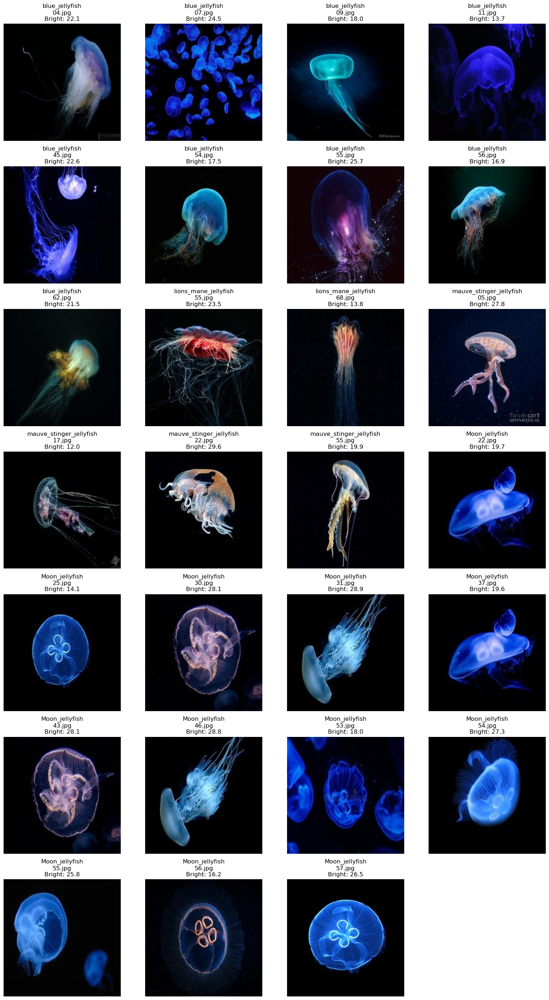

In [168]:
# 어두운 이미지 샘플 시각화

# 밝기 임계값
BRIGHTNESS_THRESHOLD = 30

# 어두운 이미지 필터링
dark_imgs = df_quality[df_quality["Brightness"] < BRIGHTNESS_THRESHOLD].reset_index(drop=True)

# 시각화
num_imgs = len(dark_imgs)
cols = 4
rows = (num_imgs + cols - 1) // cols

plt.figure(figsize=(cols * 4, rows * 4))
for i, row in enumerate(dark_imgs.itertuples()):
    img_path = os.path.join(train_path, row.Class, row.Image)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(rows, cols, i + 1)
    plt.imshow(img)
    plt.title(f"{row.Class}\n{row.Image}\nBright: {row.Brightness:.1f}")
    plt.axis("off")

plt.tight_layout()
plt.show()

### 1.5.2 결론

**확인 사항:** 이미지 품질 확인(저품질의 데이터를 학습시키면 모델 품질 또한 저하될 우려가 있으므로)   
**결론:**
- 모든 저품질(흐리거나 어두움) 이미지는 원본에서 나타났음
- 흐린 이미지의 경우, 총 900개 데이터 중 10개에 불과하기 때문에 큰 영향을 미치지 않을 것으로 판단됨
- 어두운 이미지의 경우, 모든 데이터가 배경만 어두우며, 해파리 자체는 밝음

**대응 전략:** 흐린 이미지 & 어두운 이미지 모두 그대로 사용

----
## 1.6 EDA 결론 및 전처리 전략 설계

1. 배경색 제거

</n>

2. blue jellyfish 데이터셋 내에 moon jellyfish가 들어있는 문제
   1) moon jellyfish 선학습
   2) moon jellyfish 모델로 blue jellyfish 내의 이미지 판별
   3) moon jellyfish라고 판별 된 이미지 제거 후 나머지 이미지 증강   

</n>

3. (확인 후 대응) 한 이미지 내에 복수 해파리가 있는 경우 대응 필요할지 판단

</n>

4. (사후 대응) 학습 데이터셋이 부족한 경우 추가 증강

</n>

5. (사후 대응) 66쌍의 약한 증강을 거친 유사 이미지 셋에 대해,
   - 추후 모델의 정확도 개선이 어렵고 과적합이 빠르게 높아진다면,
     중복 이미지를 제거한 후 재증강 예정.

-----
# 2. 데이터 전처리

## 2.1 배경 제거

In [175]:
# 처리할 폴더 목록
input_folders = [
    top_path + "/barrel_jellyfish",
    top_path + "/blue_jellyfish",
    top_path + "/compass_jellyfish",
    top_path + "/lions_mane_jellyfish",
    top_path + "/mauve_stinger_jellyfish",
    top_path + "/Moon_jellyfish"
]

# 각 폴더의 이미지를 처리하는 함수
def process_folder(input_folder):
    # 출력 폴더 생성 (원본 폴더명_remove_background)
    output_folder = f"{input_folder}_remove_background"
    
    # 출력 폴더가 없으면 생성
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    # 폴더 내 이미지 파일 가져오기
    image_files = [f for f in os.listdir(input_folder) if f.endswith((".png", ".jpg", ".jpeg",".PNG",".JPG"))]
    
    print(f"폴더 '{input_folder}'에서 {len(image_files)}개 이미지 처리 시작...")
    
    # 각 이미지 파일 처리
    for img_file in image_files:
        input_path = os.path.join(input_folder, img_file)
        
        # 출력 파일명 (JPG로 저장)
        output_filename = os.path.splitext(img_file)[0] + ".jpg"
        output_path = os.path.join(output_folder, output_filename)
        
        try:
            # 이미지 로드 및 배경 제거
            with open(input_path, "rb") as input_file:
                with open(output_path, "wb") as output_file:
                    input_image = input_file.read()
                    output_image = remove(
                        input_image,
                        alpha_matting=True,
                        alpha_matting_foreground_threshold=220,
                        alpha_matting_background_threshold=20,)
                    output_file.write(output_image)
            
            print(f"  ✓ {img_file} 처리 완료")
        except Exception as e:
            print(f"  ✗ {img_file} 처리 중 오류 발생: {str(e)}")
    
    print(f"폴더 '{input_folder}' 처리 완료!\n")

# 모든 폴더 처리
for folder in input_folders:
    if os.path.exists(folder) and os.path.isdir(folder):
        process_folder(folder)
    else:
        print(f"경고: '{folder}' 폴더가 존재하지 않습니다.")

print("모든 폴더의 이미지 배경 제거 작업이 완료되었습니다!")

폴더 'C:/Users/kimho/Dlthon_c1/barrel_jellyfish'에서 150개 이미지 처리 시작...
  ✓ 01.jpeg 처리 완료
  ✓ 02.jpg 처리 완료
  ✓ 03.jpg 처리 완료
  ✓ 04.jpg 처리 완료
PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift

  ✓ 05.jpg 처리 완료
  ✓ 06.jpg 처리 완료
  ✓ 07.jpg 처리 완료
  ✓ 10.jpg 처리 완료
  ✓ 11.jpg 처리 완료
  ✓ 12.jpg 처리 완료
  ✓ 13.jpg 처리 완료
  ✓ 14.jpg 처리 완료
  ✓ 15.jpg 처리 완료
  ✓ 17.jpg 처리 완료
  ✓ 18.jpg 처리 완료
  ✓ 20.jpg 처리 완료
  ✓ 21.jpg 처리 완료
  ✓ 22.jpg 처리 완료
  ✓ 24.jpg 처리 완료
  ✓ 25.jpg 처리 완료
  ✓ 27.jpg 처리 완료
  ✓ 28.jpg 처리 완료
  ✓ 29.jpg 처리 완료
  ✓ 30.jpg 처리 완료
  ✓ 31.jpg 처리 완료
  ✓ 32.JPG 처리 완료
  ✓ 33.jpg 처리 완료
  ✓ 34.jpg 처리 완료
  ✓ 35.jpg 처리 완료
  ✓ 36.jpg 처리 완료
  ✓ 37.jpg 처리 완료
  ✓ 38.jpg 처리 완료
  ✓ 39.JPG 처리 완료
  ✓ 40.jpg 처리 완료
  ✓ 41.jpg 처리 완료
  ✓ 42.jpg 처리 완료
  ✓ 45.jpg 처리 완료
  ✓ 46.jpg 처리 완료
  ✓ 47.jpg 처리 완료

----
## 2.2 blue jellyfish 데이터셋에서 moon jellyfish 골라내기

### 2.2.0 내용 요약

#### **[모델 선택 전략]**
|항목|선택 사항|선택 이유|
|--|--|--|
|**모델**|MobileNetV2 (imagenet pretrained)|- 경량 모델이라 학습 빠르고 </br> - 작은 데이터셋에서도 과적합 덜함 </br> - 이미지 분류에 널리 검증됨|
|**구조**|head만 추가: GlobalPool → Dense(64) → Dense(1, sigmoid)|표현력 + 경량성 밸런스|

#### **[분류 전략]**
|항목|설명|
|--|--|
|0~1 출력|sigmoid 결과값 → moon일 확률|
|판별 기준값 (threshold)|기본 0.5 사용 (moon일 확률 > 50%)|
|추가 검증|이미지를 뽑아서 육안으로 확인 후, threshold 조정|

### 2.2.1 moon jellyfish 판별 코드

Found 194 files belonging to 2 classes.
Epoch 1/5
7/7 - 8s - 1s/step - accuracy: 0.7113 - loss: 0.5770
Epoch 2/5
7/7 - 2s - 235ms/step - accuracy: 0.7784 - loss: 0.4390
Epoch 3/5
7/7 - 2s - 238ms/step - accuracy: 0.8144 - loss: 0.3781
Epoch 4/5
7/7 - 2s - 247ms/step - accuracy: 0.8351 - loss: 0.3442
Epoch 5/5
7/7 - 2s - 239ms/step - accuracy: 0.8814 - loss: 0.2507


100%|██████████████████████████████████████████████████████████████████████████████████████| 151/151 [00:27<00:00,  5.43it/s]



📸 Moon 확률 높은 상위 50개 이미지:


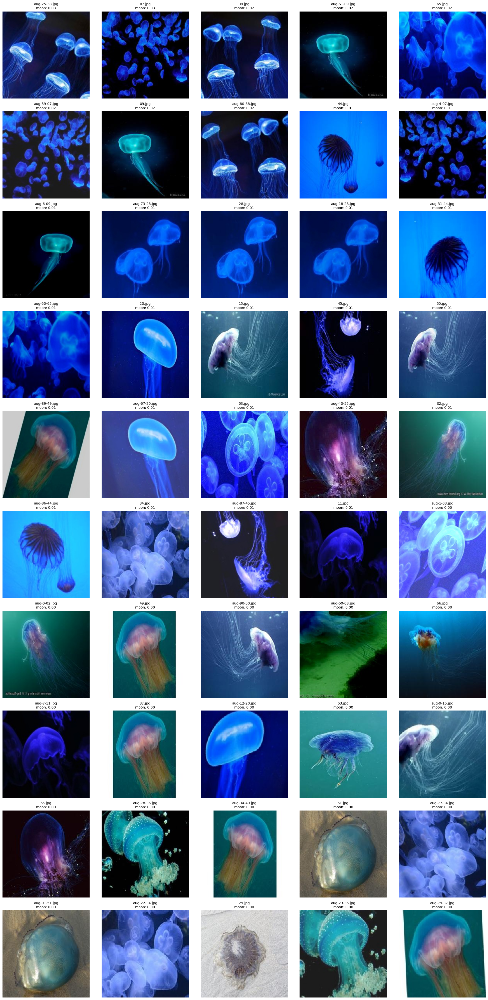

In [179]:
# ✅ 경로 설정
top_path = Path(top_path)
temp_base_path = Path(base_path)
temp_path = temp_base_path / "moon_clean_tmp"
moon_path = top_path / "Moon_jellyfish"
blue_path = top_path / "blue_jellyfish"


# ✅ Step 1: binary classification용 임시 데이터셋 생성
def prepare_binary_dataset(moon_path, blue_path, img_size=(224,224), batch_size=32):
    shutil.rmtree(temp_path, ignore_errors=True)
    os.makedirs(temp_path / 'moon', exist_ok=True)
    os.makedirs(temp_path / 'notmoon', exist_ok=True)

    for fname in os.listdir(moon_path):
        if fname.endswith('.jpg'):
            shutil.copy(moon_path / fname, temp_path / 'moon' / fname)

    blue_imgs = [f for f in os.listdir(blue_path) if f.endswith('.jpg')]
    for fname in blue_imgs[:50]:  # 일부만 notmoon
        shutil.copy(blue_path / fname, temp_path / 'notmoon' / fname)

    return image_dataset_from_directory(
        temp_path,
        label_mode='int',
        image_size=img_size,
        batch_size=batch_size
    )


# ✅ Step 2: MobileNetV2 기반 분류기 학습
def train_moon_classifier(dataset):
    base_model = MobileNetV2(include_top=False, input_shape=(224,224,3), weights='imagenet')
    base_model.trainable = False

    model = models.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),
        layers.Dense(64, activation='relu'),
        layers.Dense(1, activation='sigmoid')
    ])

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(dataset, epochs=5, verbose=2)
    return model


# ✅ Step 4: moon 확률 높은 이미지 예측 및 시각화
def visualize_top_moon_predictions(model, blue_path, top_n=50, img_size=(224,224)):
    preds = []

    for fname in tqdm(os.listdir(blue_path)):
        if not fname.endswith('.jpg'):
            continue
        fpath = blue_path / fname
        img = load_img(fpath, target_size=img_size)
        arr = img_to_array(img) / 255.0
        pred = model.predict(np.expand_dims(arr, axis=0), verbose=0)[0][0]
        preds.append((fpath, pred, img))  # (경로, 확률, 원본 이미지)

    preds.sort(key=lambda x: x[1], reverse=True)  # 확률 높은 순 정렬

    print(f"\n📸 Moon 확률 높은 상위 {top_n}개 이미지:")
    plt.figure(figsize=(20, int(top_n/5) * 4))
    for i, (fpath, prob, img) in enumerate(preds[:top_n]):
        plt.subplot(int(np.ceil(top_n/5)), 5, i+1)
        plt.imshow(img)
        plt.title(f"{fpath.name}\nmoon: {prob:.2f}", fontsize=10)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

    return preds


# 데이터셋 준비
ds = prepare_binary_dataset(moon_path, blue_path)

# 모델 학습
moon_model = train_moon_classifier(ds)

# 예측 + 상위 moon 이미지 시각화
top_preds = visualize_top_moon_predictions(moon_model, blue_path, top_n=50)


### 2.2.2 발견 사항 및 대응 전략

(코드 용량 이슈로 캡처본으로 대체)
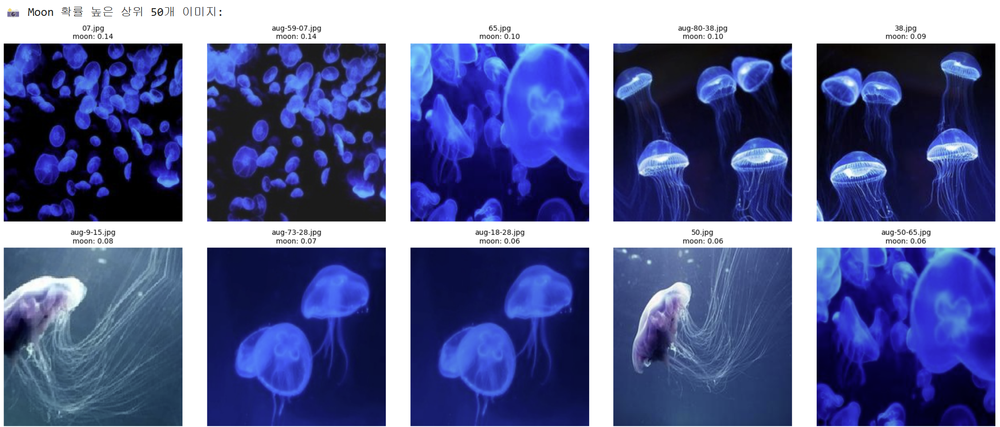

- moon jellyfish 일 확률 상위 10개 이미지를 보았을 때 **대체적으로 잘 골라냄**   
- 하지만 **일부 blue jellyfish로 추정되는 것이 섞여있음**
- 또한, moon 추정 확률 또한 **1위가 14%로** 매우 낮음

따라서, 모든 이미지를 눈으로 확인 후 수작업으로 골라냄.

**moon jellyfish 판별 기준:**
- 보수적인 판별을 위해, 우산 내부에 말굽 모양 생식선 존재할 경우만 선택

### 2.2.3 mmon jellyfish 이미지 제거

🔍 제거된 이미지 수 (moon 판단): 17
✅ 남은 원본 이미지 수: 131

🗑️ 제거된 이미지 리스트:
 - 03.jpg
 - 07.jpg
 - 28.jpg
 - 32.jpg
 - 34.jpg
 - 65.jpg
 - aug-1-03.jpg
 - aug-18-28.jpg
 - aug-21-32.jpg
 - aug-22-34.jpg
 - aug-4-07.jpg
 - aug-50-65.jpg
 - aug-56-03.jpg
 - aug-59-07.jpg
 - aug-73-28.jpg
 - aug-76-32.jpg
 - aug-77-34.jpg

🖼️ 제거된 이미지 시각화:


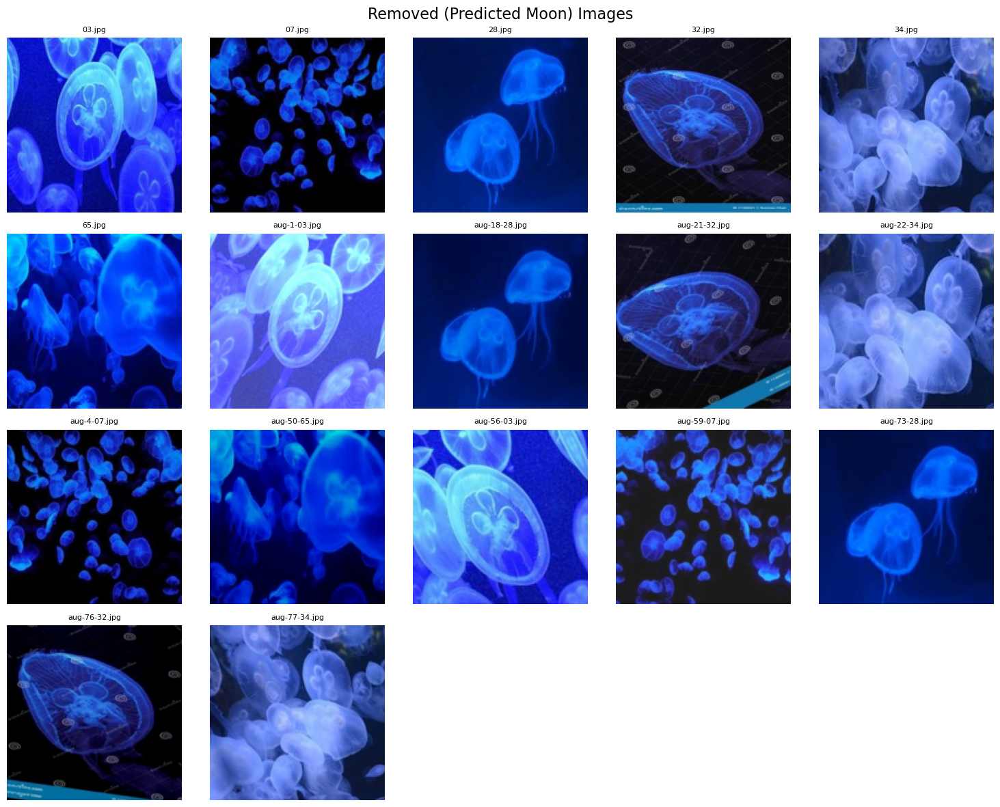

In [183]:
# ✅ 경로 설정
moon_ids = {"03", "07", "28", "32", "34", "65"}  # 제거 대상 숫자
blue_raw_path = Path(top_path) / "blue_jellyfish"
blue_clean_path = Path(top_path) / "blue_jellyfish_clean"
blue_clean_path.mkdir(parents=True, exist_ok=True)

# ✅ Step 1: moon으로 추정되는 이미지 제거
retained_images = []
removed_images = []
removed_count = 0

for fname in os.listdir(blue_raw_path):
    if not fname.lower().endswith('.jpg'):
        continue

    stem = fname.split('.')[0]  # "05", "aug-1-07" 등
    parts = stem.split('-')
    check = parts[-1]  # 마지막 숫자만 추출 (e.g., "07")

    if check in moon_ids:
        removed_images.append(fname)
        removed_count += 1
    else:
        retained_images.append(fname)

print(f"🔍 제거된 이미지 수 (moon 판단): {removed_count}")
print(f"✅ 남은 원본 이미지 수: {len(retained_images)}")

# 👉 제거된 이미지 출력
print("\n🗑️ 제거된 이미지 리스트:")
for f in removed_images:
    print(" -", f)

# 📸 이미지 시각화 함수
def show_images_from_list(img_dir, img_list, title, ncols=5, img_size=(150, 150)):
    n_imgs = len(img_list)
    nrows = (n_imgs + ncols - 1) // ncols
    plt.figure(figsize=(ncols * 3, nrows * 3))
    for idx, fname in enumerate(img_list):
        img_path = img_dir / fname
        if not img_path.exists(): continue
        img = Image.open(img_path).resize(img_size)
        plt.subplot(nrows, ncols, idx + 1)
        plt.imshow(img)
        plt.title(fname, fontsize=8)
        plt.axis('off')
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# 🔍 제거된 이미지 시각화
print("\n🖼️ 제거된 이미지 시각화:")
show_images_from_list(blue_raw_path, removed_images, "Removed (Predicted Moon) Images")

### 2.2.4 제거한 이미지 수량만큼 증강

**[증강 전략]**

- 중복 없이 증강 대상 랜덤 선택   
    - 밝은 이미지 또는 증강 수가 적은 이미지 선택 고려했으나,   
    - 특정 이미지를 과도하게 증강하는 경우가 발생하여 랜덤으로 증강 대상 선정.


✨ 증강 완료: 17장 생성
📁 저장 위치: C:\Users\kimho\Dlthon_c1\blue_jellyfish_clean

🖼️ 증강된 이미지 시각화:


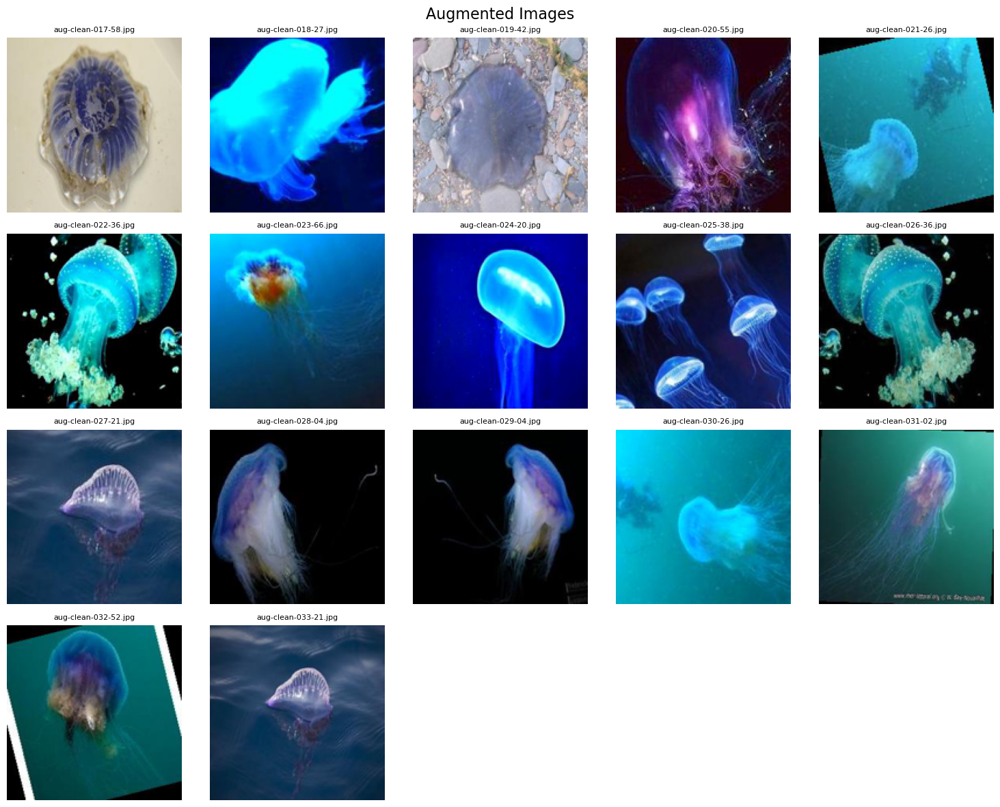

In [186]:
# ✅ 경로
blue_raw_path = Path(top_path) / "blue_jellyfish"
blue_clean_path = Path(top_path) / "blue_jellyfish_clean"
blue_clean_path.mkdir(parents=True, exist_ok=True)

# ✅ 증강 대상 수 = 제거된 이미지 수
num_to_augment = removed_count

# ✅ Step 1: 랜덤으로 증강 대상 선택 (중복 없이)
augment_targets = random.sample(retained_images, k=num_to_augment)

# ✅ Step 2: 증강 함수
def augment_image(img):
    aug_type = random.choice(['rotate', 'flip', 'color', 'contrast'])
    if aug_type == 'rotate':
        return img.rotate(random.randint(-15, 15))
    elif aug_type == 'flip':
        return ImageOps.mirror(img)
    elif aug_type == 'color':
        enhancer = ImageEnhance.Color(img)
        return enhancer.enhance(random.uniform(1.3, 1.8))
    elif aug_type == 'contrast':
        enhancer = ImageEnhance.Contrast(img)
        return enhancer.enhance(random.uniform(1.2, 1.6))
    else:
        return img

# ✅ Step 3: 증강 이미지 저장
augmented_files = []
aug_idx = len([f for f in os.listdir(blue_clean_path) if f.startswith("aug-clean")])

for fname in augment_targets:
    img_path = blue_raw_path / fname
    if not img_path.exists():
        continue

    stem = fname.split('.')[0]
    parts = stem.split('-')
    img_id = parts[-1]

    img = Image.open(img_path)
    aug_img = augment_image(img)

    aug_name = f"aug-clean-{aug_idx:03d}-{img_id}.jpg"
    aug_path = blue_clean_path / aug_name
    aug_img.save(aug_path)

    augmented_files.append(aug_name)
    aug_idx += 1

print(f"\n✨ 증강 완료: {len(augmented_files)}장 생성")
print(f"📁 저장 위치: {blue_clean_path}")

# ✅ 시각화 함수 (재사용)
def show_images_from_list(img_dir, img_list, title, ncols=5, img_size=(150, 150)):
    n_imgs = len(img_list)
    nrows = (n_imgs + ncols - 1) // ncols
    plt.figure(figsize=(ncols * 3, nrows * 3))
    for idx, fname in enumerate(img_list):
        img_path = img_dir / fname
        if not img_path.exists(): continue
        img = Image.open(img_path).resize(img_size)
        plt.subplot(nrows, ncols, idx + 1)
        plt.imshow(img)
        plt.title(fname, fontsize=8)
        plt.axis('off')
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# ✅ 증강 이미지 시각화
print("\n🖼️ 증강된 이미지 시각화:")
show_images_from_list(blue_clean_path, augmented_files, "Augmented Images")

다른 두가지 전처리에 대해서는 베이스라인 모델 설계 후 검증 과정을 거쳐 적용 예정이지만,   
해당 전처리의 경우, 잘못된 데이터셋에 대한 검열 과정이므로   
**별도 검증 과정 없이 바로 적용하도록 한다.**

----
## 2.3 한 이미지 내 복수 해파리가 있는 경우 확인 후 대응

### 2.3.0 내용 요약
- 탐구 내용 : 
    1. 하나의 **학습 이미지 내에 해파리가 여러 마리의 존재할 경우** 모델의 성능에 영향을 미치는지 확인하고자 함
    2. 따라서, 아래 두가지 케이스에 대하여 모델 성능 대조 분석
        - 단일 개체만 존재하는 학습이미지 데이터셋
        - 복수 개체가 포함된 학습이미지 데이터셋 (기존 데이터셋)
    3. Grad-CAM을 통해 모델 학습 내용 시각화

### 2.3.1 복수 개체 포함된 이미지 제거

**샘플 제거 기준**
- 비슷한 크기의 객체가 복수 존재 시 무조건 제거.
- 샘플 이미지에 완전한 객체 하나 + 가장자리에 애매하게 다른 객체가 보일 경우는 보류함.
 
**샘플 확인 방법**
- 육안 확인

In [201]:
import os
import shutil
from pathlib import Path

# ✅ 클래스별 제거 대상 번호 정의
removal_ids = {
    "barrel_jellyfish": ["20", "24", "25"],
    "mauve_stinger_jellyfish": ["06", "66"],
    "compass_jellyfish": ["31", "58"],
    "blue_jellyfish": ["03", "07", "28", "34", "38", "65"],
    "Moon_jellyfish": ["02", "03", "06", "16", "17", "18", "21", "29", "42", "45", "52", "53"],
    "lions_mane_jellyfish": ["11", "47"],
}

# ✅ 상위 경로 설정
top_path = Path(top_path)
base_path = Path(base_path)
save_root = base_path / "Train_single"
save_root.mkdir(parents=True, exist_ok=True)

# ✅ 이미지 필터링 및 복사 함수
def filter_and_copy_images(class_name, remove_ids):
    src_path = top_path / class_name
    dst_path = save_root / f"{class_name}_single"
    dst_path.mkdir(parents=True, exist_ok=True)

    removed = []
    retained = []

    for fname in os.listdir(src_path):
        if not fname.lower().endswith(".jpg"):
            continue

        stem = fname.rsplit(".", 1)[0]
        parts = stem.split("-")
        last_token = parts[-1]

        if last_token in remove_ids:
            removed.append(fname)
            continue

        # 복사
        shutil.copy(src_path / fname, dst_path / fname)
        retained.append(fname)

    print(f"✅ {class_name}: 유지 {len(retained)}장 / 제거 {len(removed)}장")
    return retained, removed

# ✅ 전체 클래스 순회
all_removed = {}
for cls, ids in removal_ids.items():
    retained, removed = filter_and_copy_images(cls, ids)
    all_removed[cls] = removed

✅ barrel_jellyfish: 유지 134장 / 제거 12장
✅ mauve_stinger_jellyfish: 유지 145장 / 제거 5장
✅ compass_jellyfish: 유지 139장 / 제거 5장
✅ blue_jellyfish: 유지 131장 / 제거 17장
✅ Moon_jellyfish: 유지 111장 / 제거 39장
✅ lions_mane_jellyfish: 유지 139장 / 제거 5장


### 2.3.2 CNN 모델 구성 및 학습

In [192]:
IMG_SIZE = 224
BATCH_SIZE = 32

#### 2.3.2.1 데이터셋 1) 원본(복수 객체 포함)

In [194]:
train_ds = tf.keras.utils.image_dataset_from_directory(
    base_path + "/Train",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    base_path + "/valid",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

test_ds = tf.keras.utils.image_dataset_from_directory(
    base_path + "/test",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

# 데이터 최적화(성능 향상)
AUTOTUNE = tf.data.AUTOTUNE
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE) # 한 번 읽은 데이터는 메모리에 저장하여 재사용, 학습 순서를 섰어 편향 학습 방지. 
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE) # 학습 도중 다음 배치 미리 준비 -> 병럴 처리로 GPU 효율 증가.
test_ds = test_ds.cache().prefetch(buffer_size=AUTOTUNE)


Found 926 files belonging to 6 classes.
Found 39 files belonging to 6 classes.
Found 40 files belonging to 6 classes.


Epoch 1/35


C:\Users\kimho\anaconda3\Lib\site-packages\keras\src\layers\preprocessing\tf_data_layer.py:19: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 713ms/step - accuracy: 0.2823 - loss: 3.2043
Epoch 1: val_accuracy improved from -inf to 0.20513, saving model to best_model8.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 26s 750ms/step - accuracy: 0.2831 - loss: 3.1794 - val_accuracy: 0.2051 - val_loss: 1.7845
Epoch 2/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 720ms/step - accuracy: 0.3682 - loss: 1.5147
Epoch 2: val_accuracy did not improve from 0.20513
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 728ms/step - accuracy: 0.3695 - loss: 1.5121 - val_accuracy: 0.1795 - val_loss: 1.7742
Epoch 3/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 707ms/step - accuracy: 0.5041 - loss: 1.2501
Epoch 3: val_accuracy did not improve from 0.20513
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 716ms/step - accuracy: 0.5040 - loss: 1.2506 - val_accuracy: 0.1795 - val_loss: 1.8435
Epoch 4/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 714ms/step - accuracy: 0.5287 - loss: 1.1801
Epoch 4: val_accuracy did not improve from 0.20513
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 724ms/step - accuracy: 0.5286 - loss: 1.1797 - val_accuracy: 0.2051 - val_loss: 1.7998
Epoch 5/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 712ms/step - accuracy: 0.5965 - loss: 1.0048
Epoch 5: val_accuracy improved 

29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 734ms/step - accuracy: 0.5963 - loss: 1.0057 - val_accuracy: 0.2308 - val_loss: 1.8053
Epoch 6/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 711ms/step - accuracy: 0.6385 - loss: 0.8966
Epoch 6: val_accuracy improved from 0.23077 to 0.25641, saving model to best_model8.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 741ms/step - accuracy: 0.6387 - loss: 0.8973 - val_accuracy: 0.2564 - val_loss: 1.7172
Epoch 7/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 718ms/step - accuracy: 0.6782 - loss: 0.8309
Epoch 7: val_accuracy did not improve from 0.25641
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 726ms/step - accuracy: 0.6787 - loss: 0.8301 - val_accuracy: 0.1538 - val_loss: 1.7303
Epoch 8/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 711ms/step - accuracy: 0.7679 - loss: 0.6627
Epoch 8: val_accuracy did not improve from 0.25641
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 720ms/step - accuracy: 0.7677 - loss: 0.6630 - val_accuracy: 0.1538 - val_loss: 1.8050
Epoch 9/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 703ms/step - accuracy: 0.7777 - loss: 0.6178
Epoch 9: val_accuracy did not improve from 0.25641
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 712ms/step - accuracy: 0.7773 - loss: 0.6188 - val_accuracy: 0.2308 - val_loss: 1.7579
Epoch 10/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 711ms/step - accuracy: 0.7926 - loss: 0.5617
Epoch 10: val_accuracy did not

29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 739ms/step - accuracy: 0.8600 - loss: 0.4267 - val_accuracy: 0.3077 - val_loss: 1.7070
Epoch 13/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 711ms/step - accuracy: 0.8472 - loss: 0.4209
Epoch 13: val_accuracy did not improve from 0.30769
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 719ms/step - accuracy: 0.8469 - loss: 0.4212 - val_accuracy: 0.3077 - val_loss: 1.7380
Epoch 14/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 712ms/step - accuracy: 0.8560 - loss: 0.4155
Epoch 14: val_accuracy improved from 0.30769 to 0.46154, saving model to best_model8.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 735ms/step - accuracy: 0.8562 - loss: 0.4148 - val_accuracy: 0.4615 - val_loss: 1.5139
Epoch 15/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 709ms/step - accuracy: 0.8844 - loss: 0.3503
Epoch 15: val_accuracy improved from 0.46154 to 0.48718, saving model to best_model8.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 733ms/step - accuracy: 0.8841 - loss: 0.3504 - val_accuracy: 0.4872 - val_loss: 1.4419
Epoch 16/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 713ms/step - accuracy: 0.8776 - loss: 0.3064
Epoch 16: val_accuracy did not improve from 0.48718
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 721ms/step - accuracy: 0.8778 - loss: 0.3069 - val_accuracy: 0.4872 - val_loss: 1.4880
Epoch 17/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 709ms/step - accuracy: 0.9002 - loss: 0.2917
Epoch 17: val_accuracy did not improve from 0.48718
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 718ms/step - accuracy: 0.8997 - loss: 0.2921 - val_accuracy: 0.4615 - val_loss: 1.4842
Epoch 18/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 720ms/step - accuracy: 0.8737 - loss: 0.3369
Epoch 18: val_accuracy improved from 0.48718 to 0.53846, saving model to best_model8.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 22s 747ms/step - accuracy: 0.8739 - loss: 0.3365 - val_accuracy: 0.5385 - val_loss: 1.4192
Epoch 19/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 712ms/step - accuracy: 0.9251 - loss: 0.2531
Epoch 19: val_accuracy did not improve from 0.53846
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 721ms/step - accuracy: 0.9251 - loss: 0.2525 - val_accuracy: 0.5385 - val_loss: 1.5344
Epoch 20/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 715ms/step - accuracy: 0.8939 - loss: 0.2982
Epoch 20: val_accuracy did not improve from 0.53846
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 724ms/step - accuracy: 0.8943 - loss: 0.2972 - val_accuracy: 0.4872 - val_loss: 1.4486
Epoch 21/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 710ms/step - accuracy: 0.9040 - loss: 0.2470
Epoch 21: val_accuracy did not improve from 0.53846
29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 719ms/step - accuracy: 0.9043 - loss: 0.2467 - val_accuracy: 0.5128 - val_loss: 1.4082
Epoch 22/35
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 714ms/step - accuracy: 0.9039 - loss: 0.2335
Epoch 22: val_accuracy d

29/29 ━━━━━━━━━━━━━━━━━━━━ 21s 736ms/step - accuracy: 0.9507 - loss: 0.1607 - val_accuracy: 0.5641 - val_loss: 1.6613


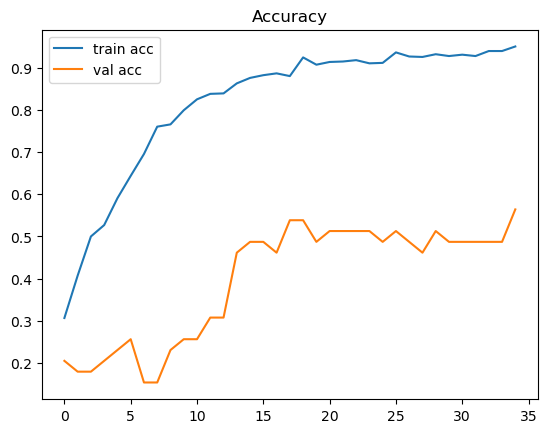

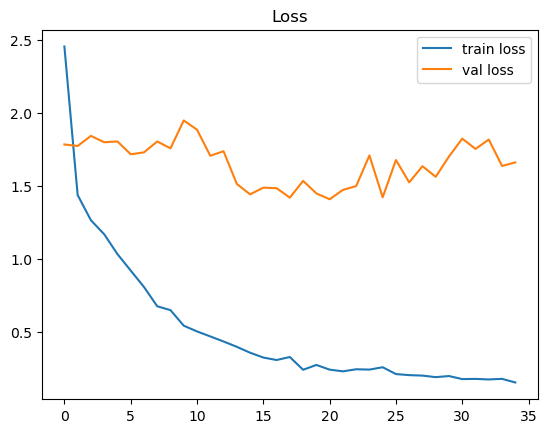

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - accuracy: 0.6583 - loss: 1.3976
Test accuracy: 0.6750, Test loss: 1.3220
                         precision    recall  f1-score   support

       barrel_jellyfish       0.75      0.50      0.60         6
         blue_jellyfish       0.83      1.00      0.91         5
      compass_jellyfish       0.62      0.71      0.67         7
   lions_mane_jellyfish       0.62      0.71      0.67         7
mauve_stinger_jellyfish       1.00      0.50      0.67         8
         Moon_jellyfish       0.50      0.71      0.59         7

               accuracy                           0.68        40
              macro avg       0.72      0.69      0.68        40
           weighted avg       0.72      0.68      0.67        40



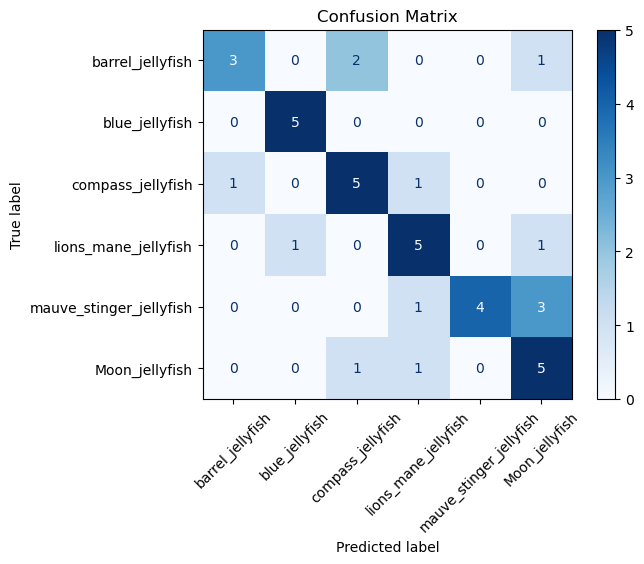

In [195]:
model_8 = models.Sequential([
    # 0~255 픽셀을 0~1로 정규화
    layers.Rescaling(1./255, input_shape=(IMG_SIZE, IMG_SIZE, 3)),

    # 첫 번째 블록
    layers.Conv2D(32, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # 두 번째 블록
    layers.Conv2D(64, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # 세 번째 블록 추가
    layers.Conv2D(128, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # Fully connected layers
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),  # dropout 다시 활성화 (오버피팅 방지)
    layers.Dense(6, activation='softmax')  # 클래스 수: 6개
])

# 컴파일
model_8.compile(
    optimizer=Adam(learning_rate=1e-4),  # 학습률 낮춤
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# 콜백 설정: val_accuracy 기준으로 최고 성능 모델 저장
checkpoint = ModelCheckpoint('best_model8.h5', monitor='val_accuracy', 
                             save_best_only=True, mode='max', verbose=1)

history = model_8.fit(
    train_ds,
    validation_data=val_ds,
    epochs=35,
    callbacks=[checkpoint]
)

plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.title('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()
plt.show()

test_loss, test_acc = model_8.evaluate(test_ds)
print(f"Test accuracy: {test_acc:.4f}, Test loss: {test_loss:.4f}")

from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
# 예측 수행
y_pred = []
y_true = []

for images, labels in test_ds:
    preds = model_8.predict(images, verbose=0)
    y_pred.extend(np.argmax(preds, axis=1))
    y_true.extend(labels.numpy())

# 클래스 목록
class_names = [
    "barrel_jellyfish",
    "blue_jellyfish",
    "compass_jellyfish",
    "lions_mane_jellyfish",
    "mauve_stinger_jellyfish",
    "Moon_jellyfish"
]

# Classification Report 출력
print(classification_report(y_true, y_pred, target_names=class_names))

# Confusion Matrix 시각화
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(xticks_rotation=45, cmap='Blues')
plt.title("Confusion Matrix")
plt.show()

#### 2.3.2.2 데이터셋 2) 복수 객체 미포함

Found 799 files belonging to 6 classes.
Epoch 1/35


C:\Users\kimho\anaconda3\Lib\site-packages\keras\src\layers\preprocessing\tf_data_layer.py:19: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 710ms/step - accuracy: 0.2644 - loss: 3.5717
Epoch 1: val_accuracy improved from -inf to 0.28205, saving model to best_model9.h5


25/25 ━━━━━━━━━━━━━━━━━━━━ 23s 749ms/step - accuracy: 0.2669 - loss: 3.5343 - val_accuracy: 0.2821 - val_loss: 1.7856
Epoch 2/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 721ms/step - accuracy: 0.4389 - loss: 1.4466
Epoch 2: val_accuracy did not improve from 0.28205
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 731ms/step - accuracy: 0.4393 - loss: 1.4441 - val_accuracy: 0.2051 - val_loss: 1.8026
Epoch 3/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 715ms/step - accuracy: 0.5517 - loss: 1.1393
Epoch 3: val_accuracy did not improve from 0.28205
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 725ms/step - accuracy: 0.5515 - loss: 1.1400 - val_accuracy: 0.2821 - val_loss: 1.8044
Epoch 4/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 719ms/step - accuracy: 0.5627 - loss: 1.1299
Epoch 4: val_accuracy did not improve from 0.28205
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 730ms/step - accuracy: 0.5637 - loss: 1.1270 - val_accuracy: 0.2821 - val_loss: 1.9425
Epoch 5/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 711ms/step - accuracy: 0.6800 - loss: 0.8566
Epoch 5: val_accuracy did not i

25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 735ms/step - accuracy: 0.9025 - loss: 0.2456 - val_accuracy: 0.3077 - val_loss: 2.3882
Epoch 16/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 715ms/step - accuracy: 0.9350 - loss: 0.2042
Epoch 16: val_accuracy improved from 0.30769 to 0.33333, saving model to best_model9.h5


25/25 ━━━━━━━━━━━━━━━━━━━━ 19s 743ms/step - accuracy: 0.9350 - loss: 0.2038 - val_accuracy: 0.3333 - val_loss: 2.5216
Epoch 17/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 704ms/step - accuracy: 0.9387 - loss: 0.2123
Epoch 17: val_accuracy improved from 0.33333 to 0.38462, saving model to best_model9.h5


25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 731ms/step - accuracy: 0.9381 - loss: 0.2131 - val_accuracy: 0.3846 - val_loss: 2.1565
Epoch 18/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 725ms/step - accuracy: 0.9359 - loss: 0.2238
Epoch 18: val_accuracy did not improve from 0.38462
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 736ms/step - accuracy: 0.9352 - loss: 0.2245 - val_accuracy: 0.3590 - val_loss: 2.3984
Epoch 19/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 731ms/step - accuracy: 0.9240 - loss: 0.2090
Epoch 19: val_accuracy improved from 0.38462 to 0.51282, saving model to best_model9.h5


25/25 ━━━━━━━━━━━━━━━━━━━━ 19s 759ms/step - accuracy: 0.9240 - loss: 0.2093 - val_accuracy: 0.5128 - val_loss: 2.0350
Epoch 20/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 718ms/step - accuracy: 0.9544 - loss: 0.1592
Epoch 20: val_accuracy did not improve from 0.51282
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 728ms/step - accuracy: 0.9545 - loss: 0.1588 - val_accuracy: 0.4872 - val_loss: 2.2518
Epoch 21/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 715ms/step - accuracy: 0.9540 - loss: 0.1274
Epoch 21: val_accuracy improved from 0.51282 to 0.56410, saving model to best_model9.h5


25/25 ━━━━━━━━━━━━━━━━━━━━ 19s 743ms/step - accuracy: 0.9538 - loss: 0.1282 - val_accuracy: 0.5641 - val_loss: 1.9557
Epoch 22/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 720ms/step - accuracy: 0.9509 - loss: 0.1497
Epoch 22: val_accuracy did not improve from 0.56410
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 730ms/step - accuracy: 0.9507 - loss: 0.1501 - val_accuracy: 0.5128 - val_loss: 2.1604
Epoch 23/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 718ms/step - accuracy: 0.9408 - loss: 0.1785
Epoch 23: val_accuracy did not improve from 0.56410
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 728ms/step - accuracy: 0.9405 - loss: 0.1787 - val_accuracy: 0.5385 - val_loss: 1.7818
Epoch 24/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 727ms/step - accuracy: 0.9577 - loss: 0.1346
Epoch 24: val_accuracy did not improve from 0.56410
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 737ms/step - accuracy: 0.9576 - loss: 0.1351 - val_accuracy: 0.5128 - val_loss: 1.9762
Epoch 25/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 730ms/step - accuracy: 0.9485 - loss: 0.1424
Epoch 25: val_accuracy d

25/25 ━━━━━━━━━━━━━━━━━━━━ 19s 768ms/step - accuracy: 0.9514 - loss: 0.1438 - val_accuracy: 0.6154 - val_loss: 2.0544
Epoch 27/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 736ms/step - accuracy: 0.9742 - loss: 0.1016
Epoch 27: val_accuracy did not improve from 0.61538
25/25 ━━━━━━━━━━━━━━━━━━━━ 19s 746ms/step - accuracy: 0.9736 - loss: 0.1023 - val_accuracy: 0.5128 - val_loss: 1.9095
Epoch 28/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 744ms/step - accuracy: 0.9500 - loss: 0.1295
Epoch 28: val_accuracy did not improve from 0.61538
25/25 ━━━━━━━━━━━━━━━━━━━━ 19s 754ms/step - accuracy: 0.9500 - loss: 0.1294 - val_accuracy: 0.5128 - val_loss: 2.1942
Epoch 29/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 737ms/step - accuracy: 0.9482 - loss: 0.1207
Epoch 29: val_accuracy did not improve from 0.61538
25/25 ━━━━━━━━━━━━━━━━━━━━ 19s 748ms/step - accuracy: 0.9480 - loss: 0.1214 - val_accuracy: 0.5385 - val_loss: 2.1163
Epoch 30/35
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 733ms/step - accuracy: 0.9731 - loss: 0.0890
Epoch 30: val_accuracy d

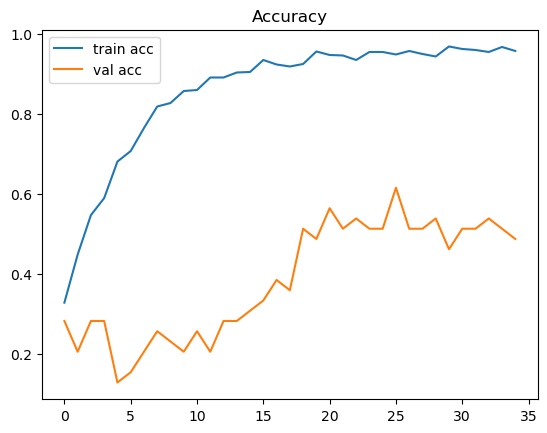

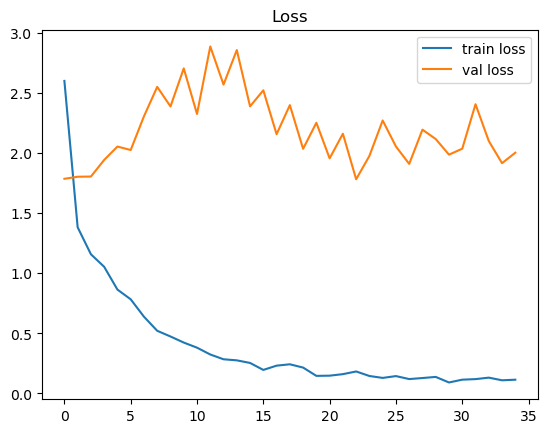

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - accuracy: 0.5708 - loss: 1.7995
Test accuracy: 0.5750, Test loss: 1.7603


                         precision    recall  f1-score   support

       barrel_jellyfish       0.45      0.83      0.59         6
         blue_jellyfish       0.60      0.60      0.60         5
      compass_jellyfish       0.80      0.57      0.67         7
   lions_mane_jellyfish       0.71      0.71      0.71         7
mauve_stinger_jellyfish       0.45      0.62      0.53         8
         Moon_jellyfish       1.00      0.14      0.25         7

               accuracy                           0.57        40
              macro avg       0.67      0.58      0.56        40
           weighted avg       0.67      0.57      0.55        40



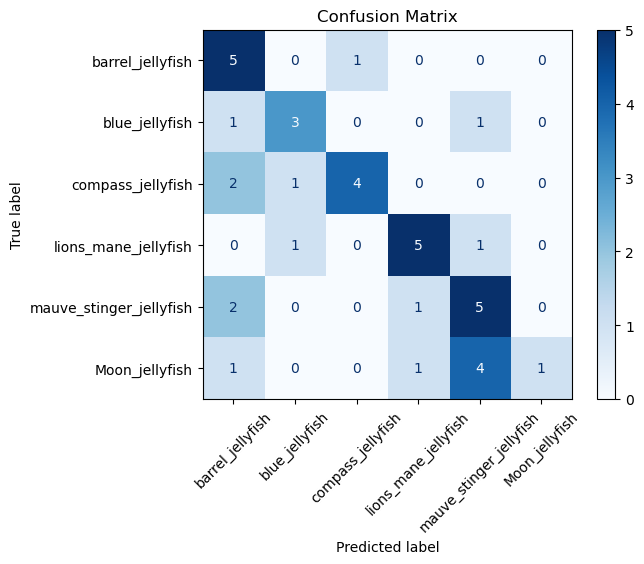

In [209]:
train_ds = tf.keras.utils.image_dataset_from_directory(
    base_path + "/Train_single",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

# 데이터 최적화(성능 향상)
AUTOTUNE = tf.data.AUTOTUNE
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE) # 한 번 읽은 데이터는 메모리에 저장하여 재사용, 학습 순서를 섰어 편향 학습 방지. 
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE) # 학습 도중 다음 배치 미리 준비 -> 병럴 처리로 GPU 효율 증가.
test_ds = test_ds.cache().prefetch(buffer_size=AUTOTUNE)

model_9 = models.Sequential([
    # 0~255 픽셀을 0~1로 정규화
    layers.Rescaling(1./255, input_shape=(IMG_SIZE, IMG_SIZE, 3)),

    # 첫 번째 블록
    layers.Conv2D(32, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # 두 번째 블록
    layers.Conv2D(64, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # 세 번째 블록 추가
    layers.Conv2D(128, (3,3), padding='same'),
    layers.BatchNormalization(),
    layers.Activation('relu'),
    layers.MaxPooling2D((2,2)),

    # Fully connected layers
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),  # dropout 다시 활성화 (오버피팅 방지)
    layers.Dense(6, activation='softmax')  # 클래스 수: 6개
])

# 컴파일
model_9.compile(
    optimizer=Adam(learning_rate=1e-4),  # 학습률 낮춤
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# 콜백 설정: val_accuracy 기준으로 최고 성능 모델 저장
checkpoint = ModelCheckpoint('best_model9.h5', monitor='val_accuracy', 
                             save_best_only=True, mode='max', verbose=1)

history = model_9.fit(
    train_ds,
    validation_data=val_ds,
    epochs=35,
    callbacks=[checkpoint]
)

plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.title('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.title('Loss')
plt.legend()
plt.show()

test_loss, test_acc = model_9.evaluate(test_ds)
print(f"Test accuracy: {test_acc:.4f}, Test loss: {test_loss:.4f}")

# 예측 수행
y_pred = []
y_true = []

for images, labels in test_ds:
    preds = model_9.predict(images, verbose=0)
    y_pred.extend(np.argmax(preds, axis=1))
    y_true.extend(labels.numpy())

# Classification Report 출력
print(classification_report(y_true, y_pred, target_names=class_names))

# Confusion Matrix 시각화
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(xticks_rotation=45, cmap='Blues')
plt.title("Confusion Matrix")
plt.show()

### 2.3.3 학습 결과 비교

**전반적 지표**
|항목|제거 전|제거 후|분석|
|-|-|-|-|
|Train Accuracy	|0.95 이상	|0.92 이상	|큰 차이 없음, 둘 다 충분히 학습|
|Val Accuracy	|최대 0.58	|최대 0.58	|**변화 거의 없음**|
|Test Accuracy	|0.475	|0.50	|**미세한 상승**, 하지만 큰 차이는 아님|
|Test Loss	|1.77	|1.76	|loss는 거의 비슷함|
|Macro F1	|0.46	|0.50	|소폭 개선됨 (class 간 균형 향상)|
|Confusion Matrix	|blue ↔ moon 혼동 / compass 오예측	|blue ↔ moon 여전히 혼동 / **compass 개선**	|일부 클래스 분별력 향상, 특히 compass_jellyfish|

**클래스 별 성능 변화 요약**
|클래스	|f1-score 변화	|해석|
|-|-|-|
|barrel_jellyfish	|0.55 → 0.60	|비슷	|
|blue_jellyfish	|0.53 → 0.44	|**감소**|
|compass_jellyfish	|0.22 → 0.40	|**크게 개선**|
|lions_mane_jellyfish	|0.55 → 0.46	|**감소**|
|mauve_stinger_jellyfish	|0.43 → 0.62	|**크게 개선**|	
|Moon_jellyfish |0.50 → 0.50	|동일


**결론**
- 복수 개체 이미지 제거가 **클래스 별로 보이는 효과가 다름.**
    - blue_jellyfish, lions_mane_jellyfish의 f1는 감소했으나,
    - compass, mauve_stinger는 분명한 향상   
- 이는 **모델이 해파리 외의 요소(배경 등)를 참고했을 가능성 있음**을 시사.
    - Grad-Cam 시각화 필요

### 2.3.3 Grad-Cam 시각화

In [211]:
model_8.summary()
print('#'*60)
model_9.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ rescaling (Rescaling)                │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 224, 224, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 224, 224, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation (Activation)              │ (None, 224, 224, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 112, 112, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 112, 112, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 112, 112, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_1 (Activation)            │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 56, 56, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 56, 56, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 56, 56, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_2 (Activation)            │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 28, 28, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 100352)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 128)                 │      12,845,184 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 6)                   │             774 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 38,819,412 (148.08 MB)

 Trainable params: 12,939,654 (49.36 MB)

 Non-trainable params: 448 (1.75 KB)

 Optimizer params: 25,879,310 (98.72 MB)

############################################################


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ rescaling_1 (Rescaling)              │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 224, 224, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 224, 224, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_3 (Activation)            │ (None, 224, 224, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 112, 112, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 112, 112, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 112, 112, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_4 (Activation)            │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 56, 56, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 56, 56, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 56, 56, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_5 (Activation)            │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 28, 28, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 100352)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 128)                 │      12,845,184 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 6)                   │             774 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 38,819,412 (148.08 MB)

 Trainable params: 12,939,654 (49.36 MB)

 Non-trainable params: 448 (1.75 KB)

 Optimizer params: 25,879,310 (98.72 MB)

In [ ]:
def get_img_array(img_path, size):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # 마지막 합성곱 층을 가져옵니다.
    last_conv_layer = model.get_layer(last_conv_layer_name)
    
    # 모델에서 마지막 합성곱 층의 출력과 모델의 예측값을 동시에 반환하는 새로운 모델을 생성합니다.
    grad_model = tf.keras.models.Model(
        [model.inputs],
        [last_conv_layer.output, model.output]
    )
    
    # 그라디언트를 기록하기 위한 GradientTape 사용
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]
    
    # 마지막 합성곱 층의 출력에 대한 기울기를 계산합니다.
    grads = tape.gradient(class_channel, conv_outputs)
    
    # 각 필터의 중요도를 평균내어 가중치를 얻습니다.
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    # 각 필터에 대해 가중치를 곱합니다.
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    
    # 0~1 사이로 스케일링
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# 이미지 경로와 사이즈
img_path = train_path + "/blue_jellyfish/03.jpg"  # 분석할 이미지 파일 경로
IMG_SIZE = (224, 224)

# 이미지 배열 변환
img_array = get_img_array(img_path, IMG_SIZE)

last_conv_layer_name = "sequential_2conv2d_2"  # MobileNetV2의 마지막 합성곱 층 이름 (모델에 따라 다름)

# Grad-CAM heatmap 생성
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# 원본 이미지 로드
img = image.load_img(img_path, target_size=IMG_SIZE)
img = image.img_to_array(img)

# heatmap을 원본 이미지에 오버레이
import cv2
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

print("\n 복수 개체 포함")
plt.figure(figsize=(10, 10))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img.astype("uint8"))
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Heatmap")
plt.imshow(heatmap)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Grad-CAM")
plt.imshow(superimposed_img.astype("uint8"))
plt.axis("off")
plt.show()

#####################

model = model_9
last_conv_layer_name = "conv2d_5"  # MobileNetV2의 마지막 합성곱 층 이름 (모델에 따라 다름)

# Grad-CAM heatmap 생성
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# 원본 이미지 로드
img = image.load_img(img_path, target_size=IMG_SIZE)
img = image.img_to_array(img)

# heatmap을 원본 이미지에 오버레이
import cv2
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

print("\n 복수 개체 제거")
plt.figure(figsize=(10, 10))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img.astype("uint8"))
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Heatmap")
plt.imshow(heatmap)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Grad-CAM")
plt.imshow(superimposed_img.astype("uint8"))
plt.axis("off")
plt.show()

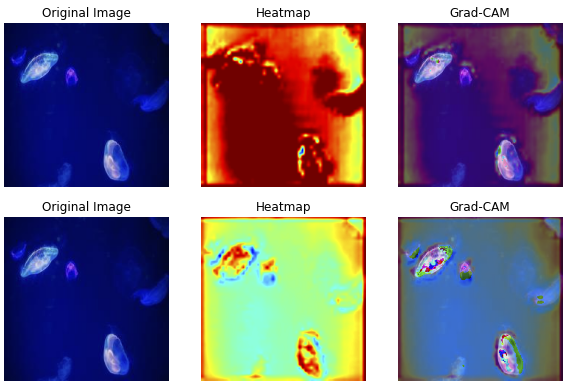

In [ ]:
# 이미지 경로와 사이즈
img_path = train_path + "/compass_jellyfish/31.jpg"
IMG_SIZE = (224, 224)

# 이미지 배열 변환
img_array = get_img_array(img_path, IMG_SIZE)

model = model_8
last_conv_layer_name = "conv2d_5"  # MobileNetV2의 마지막 합성곱 층 이름 (모델에 따라 다름)

# Grad-CAM heatmap 생성
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# 원본 이미지 로드
img = image.load_img(img_path, target_size=IMG_SIZE)
img = image.img_to_array(img)

# heatmap을 원본 이미지에 오버레이
import cv2
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

plt.figure(figsize=(10, 10))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img.astype("uint8"))
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Heatmap")
plt.imshow(heatmap)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Grad-CAM")
plt.imshow(superimposed_img.astype("uint8"))
plt.axis("off")
plt.show()

#####################

model = model_9
last_conv_layer_name = "conv2d_8"  # MobileNetV2의 마지막 합성곱 층 이름 (모델에 따라 다름)

# Grad-CAM heatmap 생성
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# 원본 이미지 로드
img = image.load_img(img_path, target_size=IMG_SIZE)
img = image.img_to_array(img)

# heatmap을 원본 이미지에 오버레이
import cv2
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img

plt.figure(figsize=(10, 10))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(img.astype("uint8"))
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Heatmap")
plt.imshow(heatmap)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Grad-CAM")
plt.imshow(superimposed_img.astype("uint8"))
plt.axis("off")
plt.show()

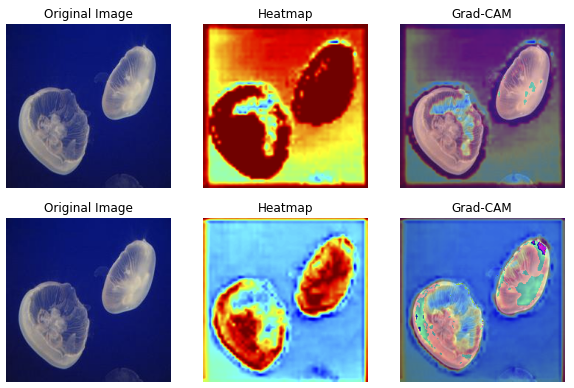

### [결론]
- Grad_Cam 비교 시, 복수 개체 샘플을 제외했을 때 개체에 더 잘 집중하며 인식함을 확인했다.
- 단, 여전히 일부 클래스에 대해 f1 점수가 하락했던 이유는 설명할 수 없다.
    - 학습 데이터의 양이 줄어든 문제도 아닐 것이다. (blue_jellyfish 제거 이미지 수: 5장, lions_mane_jellyfish: 7장)
- 따라서, **중복 개체 제거 전처리는 확실한 성능을 보장할 수 없으므로, 모델에 적용/미적용 샘플을 모두 적용해본다.**

----
# 3. Baseline 모델 설계

## 3.0 모델 톺아보기

### 3.0.1 후보 모델 목록

#### 1. CNN
   - **특징:** 전통적인 Conv → ReLU → Pool 구조 기반의 단순한 CNN
   - **장점:** 구조 이해가 쉬움, 빠른 실험 가능
   - **단점:** 성능 한계 명확
#### 2. mobilenet v2
   - **특징:** 경량화 모델 (모바일용)
   - **장점:** 빠름, 극소량의 자원에서도 학습 가능
   - **단점:** 성능 ceiling 낮음
#### 3. mobilenet v3
   - **특징:** Depthwise Separable Conv + Squeeze-Excite + NAS 기반 경량 구조 (모바일, 경량)
   - **장점:** 빠름, 적은 자원에서도 작동
   - **단점:** 표현력 한계 있음, 중간 복잡도의 태스크에서 성능 ceiling 존재
#### 4. ConvNext
   - **특징:** 최신 CNN 계열 (ViT 스타일 구조 도입)	
   - **장점:** 최신성, 성능 좋음	
   - **단점:** 무거움, baseline으론 과할 수도
#### 5. Resnet50
   - **특징:** skip connection으로 딥러닝 안정화
   - **장점:** 높은 성능, 빠른 수렴
   - **단점:** 구조 복잡도 다소 있음
#### 6. EfficientNet(5개 다 성과 잘 안나왔을 때 후보...)
   - **특징:** 계산량 대비 정확도 최고 수준
   - **장점:** 가볍고 성능 좋음 (SOTA 계열)	
   - **단점:** 구조가 black-box 느낌 있음

### 3.0.2 베이스라인 모델 요구 사항 정리 및 모델 선택

#### **[베이스라인 모델 요구사항]**
1. **데이터 특성과 모델 구조 간의 적합성**   
   Jellyfish 데이터셋은 클래스 간 색상과 형태의 유사성이 높고,   
   데이터 수가 제한적이기 때문에,   
   지나치게 깊거나 복잡한 모델은 과적합 우려가 있음.   
   -> 적당한 표현력과 경량성의 균형이 맞는 모델 필요
   
2. **모델 경량성과 실험 효율성**   
   베이스라인이므로, 빠른 실험 사이클을 가능하게 하며   
   적절한 수준의 성능까지 보장하는 모델 필요


#### **[베이스라인 모델 선택]**
요구사항의 두가지 기준을 고려하여, 해당 조건을 모두 만족시킬 수 있는   
**MobileNetV3** 로 베이스라인 모델 선정.

### 3.0.3 모든 모델에서 확인할 핵심 아웃풋 지표

|지표|설명|베이스라인 선택에 미치는 영향|
|---|---|---|
|Confusion Matrix|어떤 클래스에서 자주 틀리는지|형태 vs 색상 헷갈림 여부 분석|
|GradCAM|모델이 어디를 보고 분류했는가|모델이 의미 있는 영역 보는지 확인|
|학습 곡선|Overfitting or underfitting 빠르게 확인|복잡도에 비해 충분한 학습이 되는지|

In [ ]:
plot_training_curves(history)
plot_confusion_matrix(model, dataset, class_names, figsize=(8, 6), normalize=False, title="📊 Confusion Matrix")
show_gradcam(image_path, model, last_conv_layer_name="Conv_1", img_size=(224, 224))

----
## 3.1 베이스라인 모델 성능 검증

#### 데이터 준비

In [14]:
# 이미지 파일 경로와 레이블 수집 함수
def get_files_labels(directory):
    # 지원하는 이미지 확장자 목록
    if not isinstance(directory, Path):
        directory = Path(directory)
    image_extensions = ["*.jpg","*.jpeg", "*.png"]
    
    # 모든 확장자를 포함한 파일 수집
    all_files = []
    for ext in image_extensions:
        all_files.extend(directory.rglob(ext))
    
    file_paths = [str(f) for f in all_files]
    labels = [f.parent.name for f in all_files]
    return file_paths, labels

# 데이터셋별 파일 경로 및 레이블 로드
X_train, y_train = get_files_labels(train_path)
X_val, y_val = get_files_labels(valid_path)
X_test, y_test = get_files_labels(test_path)

print(f"Train 데이터: {len(X_train)}개")
print(f"Validation 데이터: {len(X_val)}개")
print(f"Test 데이터: {len(X_test)}개")

# 클래스 이름 정의 및 매핑 생성
class_names = sorted(set(y_train + y_val + y_test))
class_to_idx = {cls: i for i, cls in enumerate(class_names)}

# 이미지를 로드하고 전처리하는 함수 정의
def load_image(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [224, 224])  # MobileNetV3 입력 크기
    return tf.keras.applications.mobilenet_v3.preprocess_input(img)

# TensorFlow Dataset 생성 함수 정의
def create_tf_dataset(paths, labels):
    labels = [class_to_idx[label] for label in labels]
    dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
    dataset = dataset.map(lambda p, l: (load_image(p), l))  # 이미지 로드 및 전처리 적용
    return dataset

# Train/Validation/Test 데이터셋 생성
train_ds = create_tf_dataset(X_train, y_train).shuffle(1000).batch(32).prefetch(2)
valid_ds = create_tf_dataset(X_val, y_val).batch(32).prefetch(2)
test_ds = create_tf_dataset(X_test, y_test).batch(32)

Train 데이터: 900개
Validation 데이터: 39개
Test 데이터: 40개


#### 모델 구성

In [16]:
# MobileNetV3Large 로드
base_model = tf.keras.applications.MobileNetV3Large(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = True
for layer in base_model.layers[:-5]:
    layer.trainable = False

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(256, activation='relu'),  # 노드 수 증가  
    layers.Dropout(0.5),  # Dropout 비율 조정
    layers.Dense(len(class_names), activation='softmax')  # 클래스 출력층
])

# 모델 컴파일 및 학습
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ MobileNetV3Large (Functional)        │ (None, 7, 7, 960)           │       2,996,352 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_1           │ (None, 960)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 960)                 │           3,840 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │         246,016 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 6)                   │           1,542 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,247,750 (12.39 MB)

 Trainable params: 405,318 (1.55 MB)

 Non-trainable params: 2,842,432 (10.84 MB)

#### 모델 학습

In [18]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=15,
    callbacks=callbacks
)

Epoch 1/15
29/29 ━━━━━━━━━━━━━━━━━━━━ 25s 370ms/step - accuracy: 0.2473 - loss: 2.2946 - val_accuracy: 0.4872 - val_loss: 1.4929 - learning_rate: 1.0000e-04
Epoch 2/15
29/29 ━━━━━━━━━━━━━━━━━━━━ 8s 258ms/step - accuracy: 0.5723 - loss: 1.1882 - val_accuracy: 0.6154 - val_loss: 1.2014 - learning_rate: 1.0000e-04
Epoch 3/15
29/29 ━━━━━━━━━━━━━━━━━━━━ 8s 274ms/step - accuracy: 0.6989 - loss: 0.8318 - val_accuracy: 0.6667 - val_loss: 1.0707 - learning_rate: 1.0000e-04
Epoch 4/15
29/29 ━━━━━━━━━━━━━━━━━━━━ 9s 295ms/step - accuracy: 0.7764 - loss: 0.6297 - val_accuracy: 0.6667 - val_loss: 0.9874 - learning_rate: 1.0000e-04
Epoch 5/15
29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 329ms/step - accuracy: 0.8024 - loss: 0.5172 - val_accuracy: 0.6923 - val_loss: 0.9456 - learning_rate: 1.0000e-04
Epoch 6/15
29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 326ms/step - accuracy: 0.8696 - loss: 0.4014 - val_accuracy: 0.7179 - val_loss: 0.9036 - learning_rate: 1.0000e-04
Epoch 7/15
29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 343ms/step - accura

#### 성능 평가

In [22]:
# 테스트 데이터 평가
test_loss, test_acc = model.evaluate(test_ds)
print(f"테스트 손실: {test_loss:.4f}")
print(f"테스트 정확도: {test_acc:.4f}")

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 199ms/step - accuracy: 0.9187 - loss: 0.3639
테스트 손실: 0.3479
테스트 정확도: 0.9250


#### 결과 시각화 - 학습 곡선

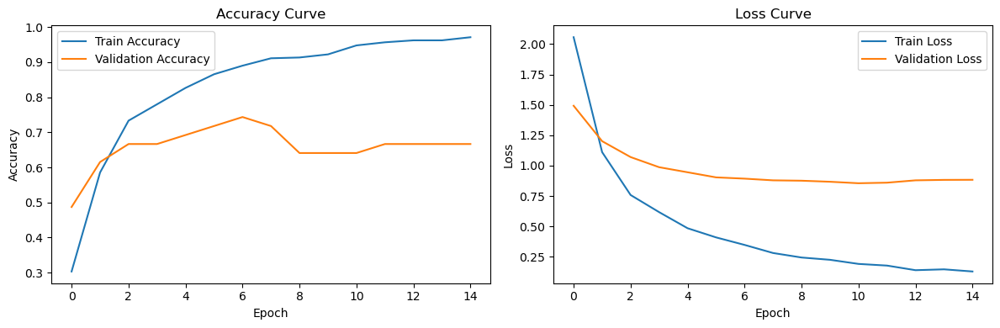

In [20]:
plt.figure(figsize=(12, 4))

# 정확도 곡선 시각화
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curve')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# 손실 곡선 시각화
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### 결과 시각화 - Confustion Maxtrix

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


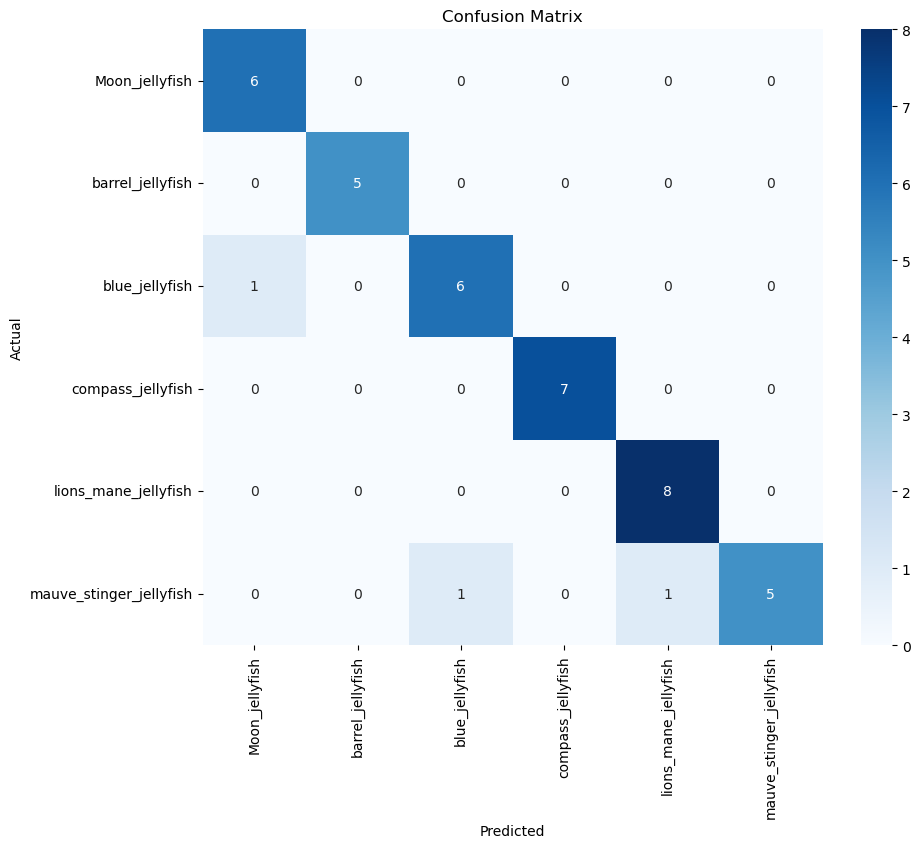

In [24]:
# 혼동 행렬 계산 및 시각화
y_pred_classes = np.concatenate([np.argmax(model.predict(x), axis=1) for x, _ in test_ds])
y_true_classes = np.concatenate([y for _, y in test_ds])

cm = confusion_matrix(y_true_classes, y_pred_classes)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

#### 결과 시각화 - Grad_Cam

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
🎯 사용된 마지막 Conv 레이어: conv_1


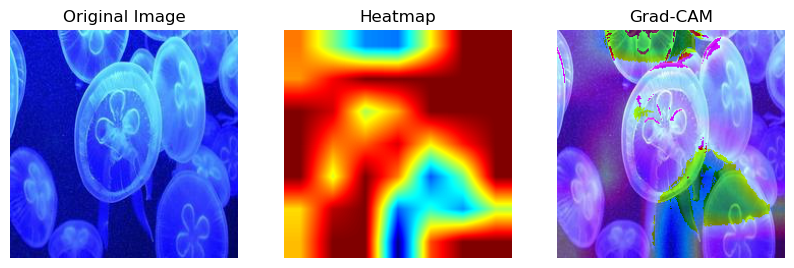

In [58]:
# 이미지 전처리
def get_img_array(img_path, size=(224, 224)):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array
    
# 마지막 Conv2D 레이어 자동 탐색 (재귀적으로)
def find_last_conv_layer(model):
    if isinstance(model, tf.keras.Sequential):
        model = model.layers[0]  # MobileNetV3Large
    for layer in reversed(model.layers):
        if isinstance(layer, tf.keras.layers.Conv2D):
            return layer.name
        elif isinstance(layer, tf.keras.Model):
            return find_last_conv_layer(layer)
    raise ValueError("Conv2D 레이어를 찾을 수 없습니다!")

# Grad-CAM 생성
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # base_model만 추출
    if isinstance(model, tf.keras.Sequential):
        base_model = model.layers[0]
    else:
        raise ValueError("지원하지 않는 모델 구조")

    last_conv_layer = base_model.get_layer(last_conv_layer_name)

    # 👉 base_model 입력 → 마지막 conv 레이어 출력만 받는 모델 구성
    conv_model = tf.keras.Model(inputs=base_model.input, outputs=last_conv_layer.output)

    # 👉 base_model 이후 classifier 부분만 따로 구성
    classifier_input = tf.keras.Input(shape=last_conv_layer.output.shape[1:])
    x = classifier_input
    for layer in model.layers[1:]:
        x = layer(x)
    classifier_model = tf.keras.Model(inputs=classifier_input, outputs=x)

    # Grad-CAM 수행
    with tf.GradientTape() as tape:
        # 1. conv feature 추출
        conv_outputs = conv_model(img_array)
        tape.watch(conv_outputs)
        # 2. classifier에 넣어 최종 예측
        preds = classifier_model(conv_outputs)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# Grad-CAM 시각화
def plot_gradcam(img_path, model, img_size=(224, 224)):
    img_array = get_img_array(img_path, img_size)
    _ = model.predict(img_array)

    last_conv_layer_name = find_last_conv_layer(model)
    print(f"🎯 사용된 마지막 Conv 레이어: {last_conv_layer_name}")

    heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

    img = image.load_img(img_path, target_size=img_size)
    img = image.img_to_array(img)

    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = heatmap * 0.4 + img

    plt.figure(figsize=(10, 10))
    plt.subplot(1, 3, 1)
    plt.title("Original Image")
    plt.imshow(img.astype("uint8"))
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.title("Heatmap")
    plt.imshow(heatmap)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.title("Grad-CAM")
    plt.imshow(superimposed_img.astype("uint8"))
    plt.axis("off")
    plt.show()

# 예시 이미지 경로
img_path = train_path + "/blue_jellyfish/03.jpg"

# Grad-CAM 시각화
plot_gradcam(img_path, model)

#### 베이스모델 성능 요약
- 테스트 손실: 0.3479
- 테스트 정확도: 0.9250

- 학습 곡선: 학습은 우수, 검증은 약간 overfitting 조짐 (6~7 에포크 부근에서 정확도 감소)
- Confusion Matrix: 대부분 클래스 정확하게 분류, 일부 혼동 (mauve ↔ blue)
- Grad-CAM: 상단 가장자리 해파리는 잘 잡았으나, 그 외에는 다소 부족한 feature 학습 확인

----
## 3.2 베이스모델로 전처리 데이터 성능 검증

전처리 적용 전, 베이스모델로 각각의 성능을 검증한 뒤 적용을 결정한다.

#### 3.2.1 배경 제거 전처리

#### 데이터 준비

In [158]:
# 데이터 경로 설정
train_path = os.path.join(base_path, "Train_remove_background")

def get_files_labels(directory):
    if not isinstance(directory, Path):
        directory = Path(directory)
    # 지원하는 이미지 확장자 목록
    image_extensions = ["*.jpg","*.jpeg", "*.png"]
    
    # 모든 확장자를 포함한 파일 수집
    all_files = []
    for ext in image_extensions:
        all_files.extend(directory.rglob(ext))
    
    file_paths = [str(f) for f in all_files]
    labels = [f.parent.name for f in all_files]
    return file_paths, labels

# 데이터셋별 파일 경로 및 레이블 로드
X_all, y_all = get_files_labels(train_path)
print(f"전체 데이터 개수: {len(X_all)}개")

# 1차 분할: train 80%, temp 20% (val+test)
X_train, X_temp, y_train, y_temp = train_test_split(
    X_all, y_all, test_size=0.2, stratify=y_all, random_state=42
)

# 2차 분할: temp → val 50%, test 50% (각각 전체의 10%)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42
)

# 결과 출력
print(f"Train 데이터: {len(X_train)}개")
print(f"Validation 데이터: {len(X_val)}개")
print(f"Test 데이터: {len(X_test)}개")

전체 데이터 개수: 900개
Train 데이터: 720개
Validation 데이터: 90개
Test 데이터: 90개


#### 이미지 전처리

In [160]:
# 클래스 이름 정의 및 매핑 생성
class_names = sorted(set(y_train + y_val + y_test))
class_to_idx = {cls: i for i, cls in enumerate(class_names)}

# 이미지를 로드하고 전처리하는 함수 정의
def load_image(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [224, 224], method='bilinear')  # MobileNetV3 입력 크기
    return tf.keras.applications.mobilenet_v3.preprocess_input(img)

# TensorFlow Dataset 생성 함수 정의
def create_tf_dataset(paths, labels):
    labels = [class_to_idx[label] for label in labels]
    dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
    dataset = dataset.map(lambda p, l: (load_image(p), l))  # 이미지 로드 및 전처리 적용
    return dataset

# Train/Validation/Test 데이터셋 생성
train_ds = create_tf_dataset(X_train, y_train).shuffle(1000).batch(32).prefetch(2)
valid_ds = create_tf_dataset(X_val, y_val).batch(32).prefetch(2)
test_ds = create_tf_dataset(X_test, y_test).batch(32)

#### 모델 구성

In [162]:
# MobileNetV3Large 로드
base_model = tf.keras.applications.MobileNetV3Large(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = True
for layer in base_model.layers[:-5]:
    layer.trainable = False

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(256, activation='relu'),  # 노드 수 증가  
    layers.Dropout(0.5),  # Dropout 비율 조정
    layers.Dense(len(class_names), activation='softmax')  # 클래스 출력층
])

# 모델 컴파일 및 학습
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ MobileNetV3Large (Functional)        │ (None, 7, 7, 960)           │       2,996,352 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_6           │ (None, 960)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 960)                 │           3,840 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 256)                 │         246,016 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_12 (Dense)                     │ (None, 6)                   │           1,542 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,247,750 (12.39 MB)

 Trainable params: 405,318 (1.55 MB)

 Non-trainable params: 2,842,432 (10.84 MB)

#### 모델 학습

In [164]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=15,
    callbacks=callbacks
)

Epoch 1/15
23/23 ━━━━━━━━━━━━━━━━━━━━ 24s 581ms/step - accuracy: 0.2598 - loss: 2.3007 - val_accuracy: 0.6000 - val_loss: 1.2248 - learning_rate: 1.0000e-04
Epoch 2/15
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 419ms/step - accuracy: 0.5350 - loss: 1.3315 - val_accuracy: 0.7000 - val_loss: 0.9598 - learning_rate: 1.0000e-04
Epoch 3/15
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 426ms/step - accuracy: 0.6949 - loss: 0.8944 - val_accuracy: 0.7556 - val_loss: 0.8081 - learning_rate: 1.0000e-04
Epoch 4/15
23/23 ━━━━━━━━━━━━━━━━━━━━ 11s 447ms/step - accuracy: 0.7474 - loss: 0.6567 - val_accuracy: 0.7778 - val_loss: 0.7101 - learning_rate: 1.0000e-04
Epoch 5/15
23/23 ━━━━━━━━━━━━━━━━━━━━ 11s 448ms/step - accuracy: 0.8132 - loss: 0.5351 - val_accuracy: 0.8111 - val_loss: 0.6394 - learning_rate: 1.0000e-04
Epoch 6/15
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 429ms/step - accuracy: 0.8281 - loss: 0.4919 - val_accuracy: 0.8222 - val_loss: 0.5793 - learning_rate: 1.0000e-04
Epoch 7/15
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 441ms/step - acc

#### 성능 평가

In [166]:
test_loss, test_acc = model.evaluate(test_ds)
print(f"테스트 손실: {test_loss:.4f}")
print(f"테스트 정확도: {test_acc:.4f}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 416ms/step - accuracy: 0.9543 - loss: 0.2638
테스트 손실: 0.2614
테스트 정확도: 0.9556


#### 결과 시각화 - 학습 곡선

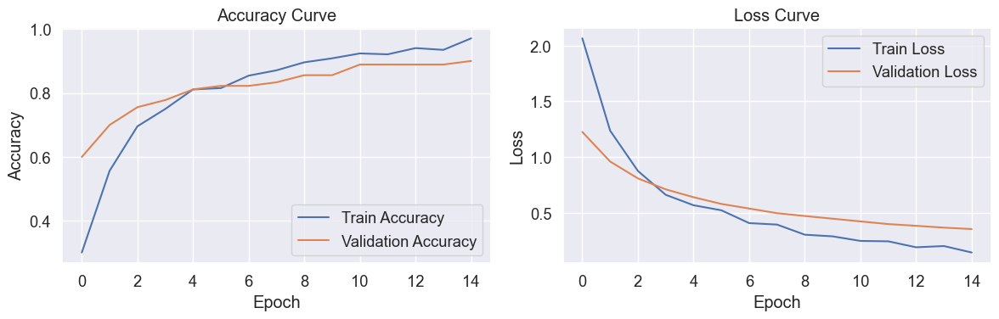

In [169]:
plt.figure(figsize=(12, 4))

# 정확도 곡선 시각화
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curve')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# 손실 곡선 시각화
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### 결과 시각화 - Confusion Matrix

3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step  


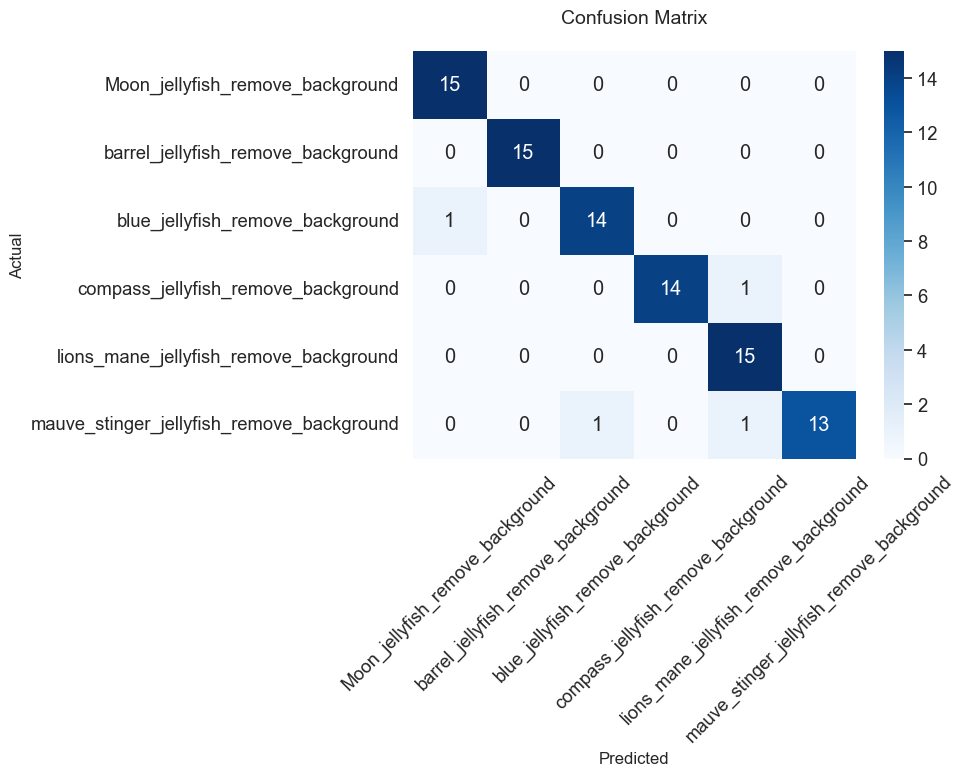

In [171]:
# 테스트 데이터 예측
y_pred = model.predict(test_ds)
y_pred_classes = np.argmax(y_pred, axis=1)

# 실제 레이블 추출
y_true = np.concatenate([y for x, y in test_ds], axis=0)

# 혼동 행렬 계산
cm = confusion_matrix(y_true, y_pred_classes)

# 시각화
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)  # 글자 크기 조정 추가
ax = sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,  
                yticklabels=class_names)  
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)  # X축 라벨 회전 추가
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)   # Y축 라벨 정렬
plt.xlabel('Predicted', fontsize=12)
plt.ylabel('Actual', fontsize=12)
plt.title('Confusion Matrix', pad=20, fontsize=14)
plt.tight_layout()  # 레이아웃 조정
plt.show()

#### 결과 시각화 - Grad_Cam

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
🎯 사용된 마지막 Conv 레이어: conv_1


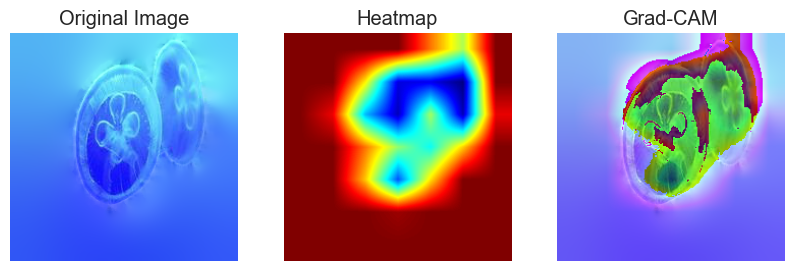

In [114]:
# 예시 이미지 경로
img_path = train_path + "/blue_jellyfish_remove_background/03.jpg"

# Grad-CAM 시각화
plot_gradcam(img_path, model)

#### 배경 제거 전처리 성능 요약

|지표|배경 제거 x|배경 제거 o|
|-|-|-|
|테스트 손실| 0.3479 | 0.2614|
|테스트 정확도| 0.9250 | 0.9556|
|학습 곡선| 학습은 우수, 검증은 약간 overfitting 조짐 (6~7 에포크 부근에서 정확도 감소) | 안정적인 우상향|
|Confusion Matrix| 대부분 클래스 정확하게 분류, 일부 혼동 (mauve ↔ blue) | 대부분 클래스 정확하게 분류|
|Grad_Cam| 상단 가장자리 해파리는 잘 잡았으나, 그 외에는 다소 부족한 feature 학습 확인 | 중앙부 해파리만 남아, 정확한 feature 학습 확인|

- **결론: 배경 제거는 적용**
    - 테스트 정확도 상승 있었으며,
    - 학습 곡선 상으로 아직 과적합 양상 또한 보이지 않음.
    - 따라서, 에포크 증가 시 전처리 전 대비 나은 성능을 보일 것으로 예상됨.

### 3.1.2 한 이미지 내에 여러 개체가 있는 경우를 제거한 데이터 성능검증

#### 데이터 준비

In [ ]:
# 한 이미지 내에 여러 개체가 있는 경우를 제거한 데이터 경로 설정
if os.path.exists("/aiffel/aiffel/jellyfish/Train_Test_Valid"):
    base_path = "/aiffel/aiffel/jellyfish/Train_Test_Valid"
elif os.path.exists("C:/Users/kimho/Dlthon_c1/Train_Test_Valid"):
    base_path = "C:/Users/kimho/Dlthon_c1/Train_Test_Valid"
elif os.path.exists("/root/aiffel/jellyfish/Train_Test_Valid"):
    base_path = "/root/aiffel/jellyfish/Train_Test_Valid"
train_path = os.path.join(base_path, "Train_Single")


# 클래스별 제거 수 정의
removed_counts = {
    "barrel_jellyfish_single": 12,
    "mauve_stinger_jellyfish_single": 5,
    "compass_jellyfish_single": 5,
    "blue_jellyfish_single": 17,
    "Moon_jellyfish_single": 39,
    "lions_mane_jellyfish_single": 5
}

# 증강 함수 정의
def augment_image(image):
    ops = [
        lambda x: x.transpose(Image.FLIP_LEFT_RIGHT),
        lambda x: x.rotate(random.uniform(-25, 25)),
        lambda x: ImageEnhance.Brightness(x).enhance(random.uniform(0.7, 1.3)),
        lambda x: ImageEnhance.Color(x).enhance(random.uniform(0.6, 1.4))
    ]
    op = random.choice(ops)
    return op(image)

# 증강 시작
augmented_files = []

for cls, n_aug in removed_counts.items():
    cls_path = Path(train_path) / cls
    images = list(cls_path.glob("*.jpg")) + list(cls_path.glob("*.jpeg")) + list(cls_path.glob("*.png"))
    
    if len(images) == 0:
        print(f"⚠️ 클래스 {cls}에 이미지 없음!")
        continue
    
    samples = random.choices(images, k=n_aug)  # 중복 허용
    for i, img_path in enumerate(samples):
        img = Image.open(img_path)
        aug = augment_image(img)
        new_name = f"aug_{i:03d}.jpg"
        aug.save(cls_path / new_name)
        augmented_files.append((cls, new_name))

print(f"✅ 총 {len(augmented_files)}장의 증강 이미지 생성 완료!\n")


In [219]:
def get_files_labels(directory):
    if not isinstance(directory, Path):
        directory = Path(directory)
    # 지원하는 이미지 확장자 목록
    image_extensions = ["*.jpg", "*.jpeg", "*.png", "*.JPG", "*.JPEG", "*.PNG"]
    
    # 모든 확장자를 포함한 파일 수집
    all_files = []
    for ext in image_extensions:
        all_files.extend(directory.rglob(ext))
    
    file_paths = [str(f) for f in all_files]
    labels = [f.parent.name for f in all_files]
    return file_paths, labels

# 데이터셋별 파일 경로 및 레이블 로드
# 1차 분할: train 80%, temp 20% (val+test)
X_train, X_temp, y_train, y_temp = train_test_split(
    X_all, y_all, test_size=0.2, stratify=y_all, random_state=42
)

# 2차 분할: temp → val 50%, test 50% (각각 전체의 10%)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42
)

# 결과 출력
print(f"전체 데이터: {len(X_all)}개")
print(f"Train 데이터: {len(X_train)}개")
print(f"Validation 데이터: {len(X_val)}개")
print(f"Test 데이터: {len(X_test)}개")

전체 데이터: 799개
Train 데이터: 639개
Validation 데이터: 80개
Test 데이터: 80개


#### 이미지 전처리

In [221]:
# 클래스 이름 정의 및 매핑 생성
class_names = sorted(set(y_train + y_val + y_test))
class_to_idx = {cls: i for i, cls in enumerate(class_names)}

# 이미지를 로드하고 전처리하는 함수 정의
def load_image(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [224, 224])  # MobileNetV3 입력 크기
    return tf.keras.applications.mobilenet_v3.preprocess_input(img)

# TensorFlow Dataset 생성 함수 정의
def create_tf_dataset(paths, labels):
    labels = [class_to_idx[label] for label in labels]
    dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
    dataset = dataset.map(lambda p, l: (load_image(p), l))  # 이미지 로드 및 전처리 적용
    return dataset

# Train/Validation/Test 데이터셋 생성
train_ds = create_tf_dataset(X_train, y_train).shuffle(1000).batch(32).prefetch(2)
valid_ds = create_tf_dataset(X_val, y_val).batch(32).prefetch(2)
test_ds = create_tf_dataset(X_test, y_test).batch(32)

#### 모델 구성

In [223]:
# MobileNetV3Large 로드
base_model = tf.keras.applications.MobileNetV3Large(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
base_model.trainable = True
for layer in base_model.layers[:-5]:
    layer.trainable = False

# 사용자 정의 분류기 추가
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(256, activation='relu'),  # 노드 수 증가  
    layers.Dropout(0.5),  # Dropout 비율 조정
    layers.Dense(len(class_names), activation='softmax')  # 클래스 출력층
])

# 모델 컴파일 및 학습
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ MobileNetV3Large (Functional)        │ (None, 7, 7, 960)           │       2,996,352 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_9           │ (None, 960)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_9                │ (None, 960)                 │           3,840 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_17 (Dense)                     │ (None, 256)                 │         246,016 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_9 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_18 (Dense)                     │ (None, 6)                   │           1,542 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,247,750 (12.39 MB)

 Trainable params: 405,318 (1.55 MB)

 Non-trainable params: 2,842,432 (10.84 MB)

#### 모델 학습

In [225]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-5)
]

history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=15,
    callbacks=callbacks
)


Epoch 1/15
20/20 ━━━━━━━━━━━━━━━━━━━━ 25s 757ms/step - accuracy: 0.2144 - loss: 2.4760 - val_accuracy: 0.4125 - val_loss: 1.4762 - learning_rate: 1.0000e-04
Epoch 2/15
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 476ms/step - accuracy: 0.4388 - loss: 1.5970 - val_accuracy: 0.6125 - val_loss: 1.0655 - learning_rate: 1.0000e-04
Epoch 3/15
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 477ms/step - accuracy: 0.6233 - loss: 0.9881 - val_accuracy: 0.7250 - val_loss: 0.8350 - learning_rate: 1.0000e-04
Epoch 4/15
20/20 ━━━━━━━━━━━━━━━━━━━━ 9s 426ms/step - accuracy: 0.7891 - loss: 0.6715 - val_accuracy: 0.7875 - val_loss: 0.6837 - learning_rate: 1.0000e-04
Epoch 5/15
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 474ms/step - accuracy: 0.8010 - loss: 0.5657 - val_accuracy: 0.8750 - val_loss: 0.5742 - learning_rate: 1.0000e-04
Epoch 6/15
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 484ms/step - accuracy: 0.8463 - loss: 0.4579 - val_accuracy: 0.8875 - val_loss: 0.5027 - learning_rate: 1.0000e-04
Epoch 7/15
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 493ms/step - accu

#### 성능 평가

In [227]:
test_loss, test_acc = model.evaluate(test_ds)
print(f"테스트 손실: {test_loss:.4f}")
print(f"테스트 정확도: {test_acc:.4f}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 432ms/step - accuracy: 0.8953 - loss: 0.3562
테스트 손실: 0.3271
테스트 정확도: 0.9000


#### 결과 시각화 - 학습 곡선

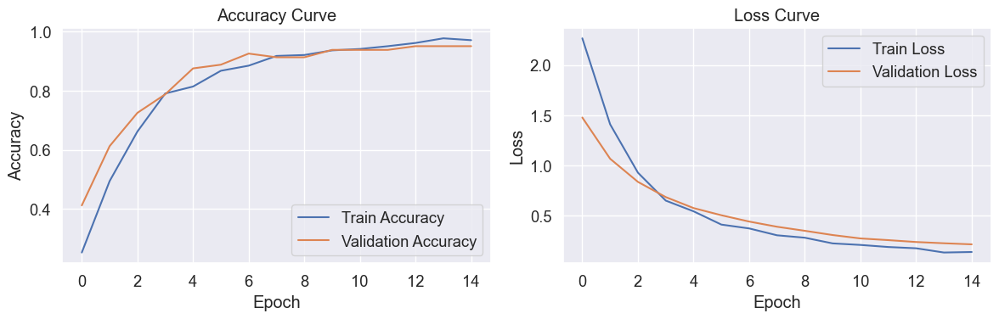

In [229]:
plt.figure(figsize=(12, 4))

# 정확도 곡선 시각화
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curve')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# 손실 곡선 시각화
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### 결과 시각화 - Confusion Matrix

3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step  


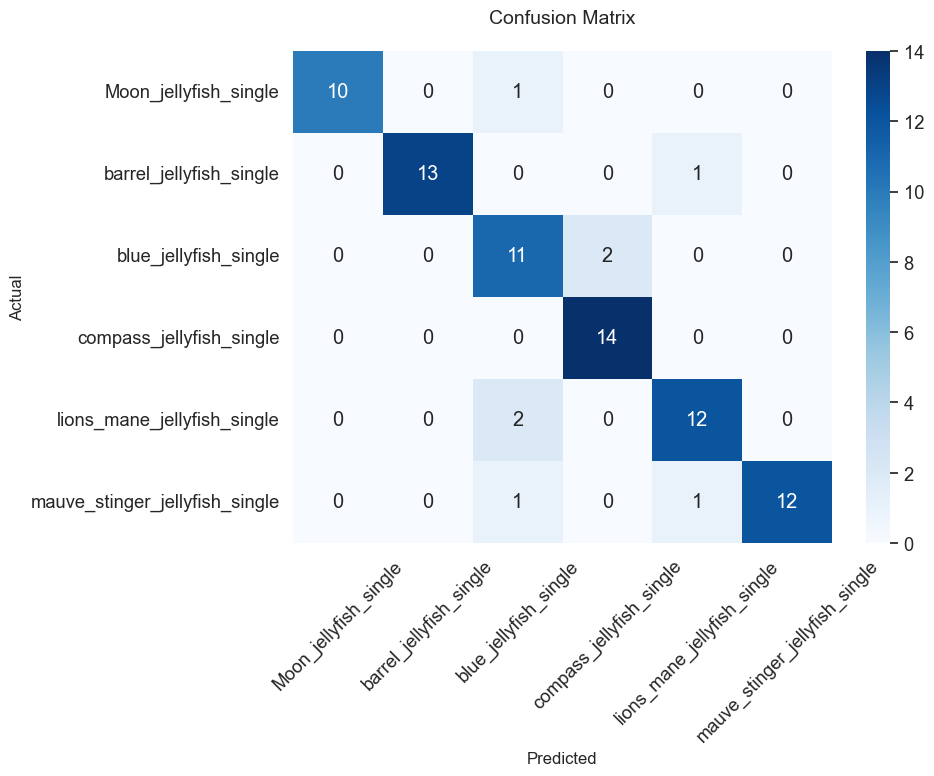

In [231]:
# 테스트 데이터 예측
y_pred = model.predict(test_ds)
y_pred_classes = np.argmax(y_pred, axis=1)

# 실제 레이블 추출
y_true = np.concatenate([y for x, y in test_ds], axis=0)

# 혼동 행렬 계산
cm = confusion_matrix(y_true, y_pred_classes)

# 시각화
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)  # 글자 크기 조정 추가
ax = sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,  
                yticklabels=class_names)  
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)  # X축 라벨 회전 추가
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)   # Y축 라벨 정렬
plt.xlabel('Predicted', fontsize=12)
plt.ylabel('Actual', fontsize=12)
plt.title('Confusion Matrix', pad=20, fontsize=14)
plt.tight_layout()  # 레이아웃 조정
plt.show()

#### 결과 시각화 - Grad Cam

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
🎯 사용된 마지막 Conv 레이어: conv_1


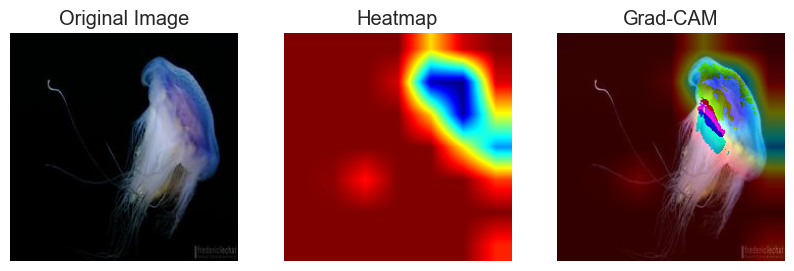

In [233]:
# 예시 이미지 경로
img_path = train_path + "/blue_jellyfish_single/04.jpg"

# Grad-CAM 시각화
plot_gradcam(img_path, model)

#### 중복 개체 제거 전처리 성능 요약

|지표|중복 개체 제거 x|중복 개체 제거 o|
|-|-|-|
|테스트 손실| 0.3479 | 0.3271
|테스트 정확도| 0.9250 | 0.9000|
|학습 곡선| 학습은 우수, 검증은 약간 overfitting 조짐 (6~7 에포크 부근에서 정확도 감소) | 비교적 꾸준한 우상향|
|Confusion Matrix| 대부분 클래스 정확하게 분류, 일부 혼동 (mauve ↔ blue) | 비교적 다양한 클래스에서 혼동|
|Grad_Cam| - | 해파리 중심부에 올바른 feature 학습 확인|

- **결론: 중복 개체 제거 전처리 성능은 좋으나 미적용**
    - 테스트 정확도의 소폭 하락 있었으나, 학습 데이터 수 감소(900-> 800) 으로 인한 영향까지 생각하면 매우 미미한 수준.
    - 학습 곡선 상에서도 뚜렷한 과적합 양상 보이지 않아, 에포크 늘림으로써 정확도 향상 가능성 있어보임.
    - 다만, **해당 전처리가 들어간다면, test 셋에서도 동일하게 중복 개체 제거하는 전처리가 필요함.**
    - 이는 불가능한 작업이므로, 제외시킴.

## 3.3 최종 전처리 데이터 생성

In [263]:
# 📍 기본 경로 설정
#top_path
if os.path.exists("/aiffel/aiffel/jellyfish"):
    top_path = "/aiffel/aiffel/jellyfish"
elif os.path.exists("C:/Users/kimho/Dlthon_c1"):
    top_path = "C:/Users/kimho/Dlthon_c1"
elif os.path.exists("/root/aiffel/jellyfish"):
    top_path = "/root/aiffel/jellyfish"

#base_path(Train_Test_valid 폴더)
if os.path.exists("/aiffel/aiffel/jellyfish/Train_Test_Valid"):
    base_path = "/aiffel/aiffel/jellyfish/Train_Test_Valid"
elif os.path.exists("C:/Users/kimho/Dlthon_c1/Train_Test_Valid"):
    base_path = "C:/Users/kimho/Dlthon_c1/Train_Test_Valid"
elif os.path.exists("/root/aiffel/jellyfish/Train_Test_Valid"):
    base_path = "/root/aiffel/jellyfish/Train_Test_Valid"

base_path = Path(base_path)
top_path = Path(top_path)

train_src_path = base_path / "Train"
valid_src_path = base_path / "valid"
test_src_path = base_path / "test"
blue_clean_path = top_path / "blue_jellyfish_clean"

train_dst_path = base_path / "Train_preprocessing"
valid_dst_path = base_path / "valid_preprocessing"
test_dst_path = base_path / "test_preprocessing"

# 🧼 배경 제거 함수
def remove_background_rmbg(input_path, output_path):
    try:
        with open(input_path, "rb") as input_file:
            with open(output_path, "wb") as output_file:
                input_image = input_file.read()
                output_image = remove(
                    input_image,
                    alpha_matting=True,
                    alpha_matting_foreground_threshold=220,
                    alpha_matting_background_threshold=20
                )
                output_file.write(output_image)
    except Exception as e:
        print(f"❗ {input_path.name} 처리 실패: {e}")

# 📦 전처리 함수 (rmbg 적용 + 저장)
def preprocess_with_rmbg(src_folder, dst_folder, override_blue_path=None):
    shutil.rmtree(dst_folder, ignore_errors=True)
    dst_folder.mkdir(parents=True, exist_ok=True)

    for cls_folder in sorted(src_folder.iterdir()):
        if not cls_folder.is_dir(): continue
        cls_name = cls_folder.name

        if override_blue_path and cls_name == "blue_jellyfish":
            cls_folder = override_blue_path

        dst_cls_path = dst_folder / cls_name
        dst_cls_path.mkdir(parents=True, exist_ok=True)

        image_files = list(cls_folder.glob("*.[jJpP]*[gG]"))

        for img_path in tqdm(image_files, desc=f"📂 {cls_name:22}"):
            output_filename = img_path.stem + ".jpg"
            output_path = dst_cls_path / output_filename
            remove_background_rmbg(img_path, output_path)

# 🔧 전처리 실행
print("✅ Train 전처리 시작")
preprocess_with_rmbg(train_src_path, train_dst_path, override_blue_path=blue_clean_path)

print("✅ Valid 전처리 시작")
preprocess_with_rmbg(valid_src_path, valid_dst_path)

print("✅ Test 전처리 시작")
preprocess_with_rmbg(test_src_path, test_dst_path)

print("🎉 모든 전처리 완료!")


✅ Train 전처리 시작


📂 barrel_jellyfish      :   3%|█▋                                                           | 4/150 [00:09<05:35,  2.30s/it]

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift



📂 barrel_jellyfish      :  90%|█████████████████████████████████████████████████████      | 135/150 [04:52<00:33,  2.24s/it]

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift



📂 blue_jellyfish        :  16%|█████████▍                                                  | 26/165 [00:56<04:58,  2.15s/it]

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift



📂 lions_mane_jellyfish  :  33%|████████████████████                                        | 50/150 [01:55<03:40,  2.21s/it]

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 1.000000e-04
Try decreasing discard_threshold or start with a larger shift

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 1.000000e-03
Try decreasing discard_threshold or start with a larger shift



📂 lions_mane_jellyfish  :  87%|███████████████████████████████████████████████████▏       | 130/150 [04:54<00:44,  2.20s/it]

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift



📂 lions_mane_jellyfish  :  94%|███████████████████████████████████████████████████████▍   | 141/150 [05:18<00:19,  2.20s/it]

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift



📂 Moon_jellyfish        :  76%|████████████████████████████████████████████▊              | 114/150 [04:07<01:19,  2.21s/it]

PERFORMANCE WARNING:
Thresholded incomplete Cholesky decomposition failed due to insufficient positive-definiteness of matrix A with parameters:
    discard_threshold = 1.000000e-04
    shift = 0.000000e+00
Try decreasing discard_threshold or start with a larger shift



📂 Moon_jellyfish        : 100%|███████████████████████████████████████████████████████████| 150/150 [05:24<00:00,  2.16s/it]


✅ Valid 전처리 시작


📂 Moon_jellyfish        : 100%|███████████████████████████████████████████████████████████████| 6/6 [00:13<00:00,  2.21s/it]


✅ Test 전처리 시작


📂 Moon_jellyfish        : 100%|███████████████████████████████████████████████████████████████| 6/6 [00:12<00:00,  2.14s/it]

🎉 모든 전처리 완료!


In [267]:
IMG_SIZE = 224
BATCH_SIZE = 32

train_ds = tf.keras.utils.image_dataset_from_directory(
    base_path / "Train_preprocessing",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    base_path / "valid_preprocessing",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

test_ds = tf.keras.utils.image_dataset_from_directory(
    base_path / "test_preprocessing",
    image_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE
)

Found 915 files belonging to 6 classes.
Found 39 files belonging to 6 classes.
Found 40 files belonging to 6 classes.


# 4. 모델 성능 개선

## 4.1 여러 모델 테스트

베이스모델 선정 시 고려했던 4가지 모델에 대한 실험 진행

**[모델 목록]**
1. **CNN**
   - **특징:** 전통적인 Conv → ReLU → Pool 구조 기반의 단순한 CNN
   - **장점:** 구조 이해가 쉬움, 빠른 실험 가능
   - **단점:** 성능 한계 명확
2. **mobilenet v2**
   - **특징:** 경량화 모델 (모바일용)
   - **장점:** 빠름, 극소량의 자원에서도 학습 가능
   - **단점:** 성능 ceiling 낮음
3. **ConvNext**
   - **특징:** 최신 CNN 계열 (ViT 스타일 구조 도입)	
   - **장점:** 최신성, 성능 좋음	
   - **단점:** 무거움, baseline으론 과할 수도
4. **Resnet50**
   - **특징:** skip connection으로 딥러닝 안정화
   - **장점:** 높은 성능, 빠른 수렴
   - **단점:** 구조 복잡도 다소 있음

### 4.1.1 CNN

**베이스 모델과 비교 포인트**   
|항목|설명|
|-|-|
|**장점**| 파라미터 수 적고 빠름, 과적합 조절 쉬움|
|**베이스라인 대비 기대 효과**| - **유사 클래스 구분에 대한 형태 기반 커스터마이징** 가능</br>- 작은 데이터셋에서는 오히려 더 성능 안정적|


In [321]:
#모델 정의
model_cnn = models.Sequential([
    layers.Conv2D(32, (3,3), activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3)),
    layers.MaxPooling2D((2,2)),
    
    layers.Conv2D(64, (3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),

    layers.Conv2D(128, (3,3), activation='relu'),  # 추가
    layers.MaxPooling2D((2,2)),

    layers.GlobalAveragePooling2D(),  # Flatten 대신 GAP 사용
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(6, activation='softmax')
])

# 컴파일 및 학습
checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', # 콜백 설정: val_accuracy 기준으로 최고 성능 모델 저장
                             save_best_only=True, mode='max', verbose=1)

model_cnn.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy', # 분류 문제 때 사용
              metrics=['accuracy']) # 정확도를 측정

history = model_cnn.fit(
    train_ds,
    validation_data=val_ds,
    epochs=20,
    callbacks=[checkpoint]
)

Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step - accuracy: 0.2842 - loss: 2.9396
Epoch 1: val_accuracy improved from -inf to 0.46154, saving model to best_model.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 14s 411ms/step - accuracy: 0.2853 - loss: 2.9112 - val_accuracy: 0.4615 - val_loss: 1.3508
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step - accuracy: 0.3824 - loss: 1.4954
Epoch 2: val_accuracy did not improve from 0.46154
29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 408ms/step - accuracy: 0.3836 - loss: 1.4932 - val_accuracy: 0.4359 - val_loss: 1.3901
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step - accuracy: 0.3953 - loss: 1.4399
Epoch 3: val_accuracy did not improve from 0.46154
29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 404ms/step - accuracy: 0.3960 - loss: 1.4394 - val_accuracy: 0.4359 - val_loss: 1.2592
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step - accuracy: 0.4180 - loss: 1.3955
Epoch 4: val_accuracy did not improve from 0.46154
29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 411ms/step - accuracy: 0.4188 - loss: 1.3943 - val_accuracy: 0.4615 - val_loss: 1.2449
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - accuracy: 0.4511 - loss: 1.4381
Epoch 5: val_accuracy did not i

29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 405ms/step - accuracy: 0.4791 - loss: 1.3455 - val_accuracy: 0.5385 - val_loss: 1.1487
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - accuracy: 0.4578 - loss: 1.3455
Epoch 7: val_accuracy improved from 0.53846 to 0.56410, saving model to best_model.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 414ms/step - accuracy: 0.4585 - loss: 1.3446 - val_accuracy: 0.5641 - val_loss: 1.2232
Epoch 8/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step - accuracy: 0.4589 - loss: 1.3376
Epoch 8: val_accuracy improved from 0.56410 to 0.58974, saving model to best_model.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 419ms/step - accuracy: 0.4598 - loss: 1.3363 - val_accuracy: 0.5897 - val_loss: 1.1091
Epoch 9/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step - accuracy: 0.4969 - loss: 1.2465
Epoch 9: val_accuracy did not improve from 0.58974
29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 411ms/step - accuracy: 0.4977 - loss: 1.2453 - val_accuracy: 0.5897 - val_loss: 1.1645
Epoch 10/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - accuracy: 0.5255 - loss: 1.2663
Epoch 10: val_accuracy did not improve from 0.58974
29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 411ms/step - accuracy: 0.5255 - loss: 1.2648 - val_accuracy: 0.5897 - val_loss: 1.2323
Epoch 11/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step - accuracy: 0.4716 - loss: 1.3081
Epoch 11: val_accuracy improved from 0.58974 to 0.61538, saving model to best_model.h5


29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 406ms/step - accuracy: 0.4729 - loss: 1.3056 - val_accuracy: 0.6154 - val_loss: 1.1401
Epoch 12/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step - accuracy: 0.5463 - loss: 1.1993
Epoch 12: val_accuracy did not improve from 0.61538
29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 410ms/step - accuracy: 0.5462 - loss: 1.1988 - val_accuracy: 0.4615 - val_loss: 1.2173
Epoch 13/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step - accuracy: 0.5343 - loss: 1.1931
Epoch 13: val_accuracy did not improve from 0.61538
29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 415ms/step - accuracy: 0.5355 - loss: 1.1908 - val_accuracy: 0.4615 - val_loss: 1.2827
Epoch 14/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step - accuracy: 0.5691 - loss: 1.1144
Epoch 14: val_accuracy did not improve from 0.61538
29/29 ━━━━━━━━━━━━━━━━━━━━ 12s 411ms/step - accuracy: 0.5697 - loss: 1.1139 - val_accuracy: 0.4615 - val_loss: 1.3529
Epoch 15/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step - accuracy: 0.5530 - loss: 1.1896
Epoch 15: val_accuracy d

In [337]:
# test 확인
test_loss, test_acc = model_cnn.evaluate(test_ds)
print(f"Test accuracy: {test_acc:.4f}, Test loss: {test_loss:.4f}")

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - accuracy: 0.5229 - loss: 1.1477 
Test accuracy: 0.5500, Test loss: 1.0828


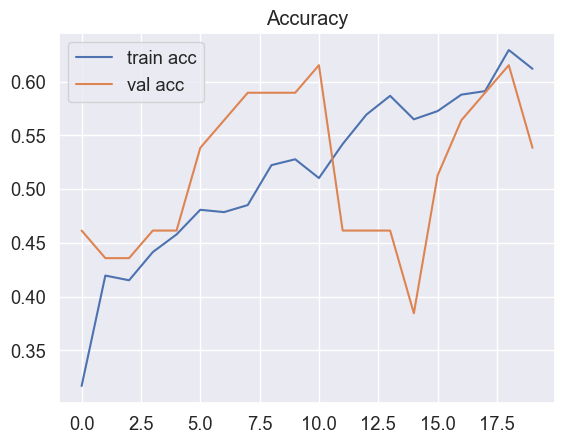

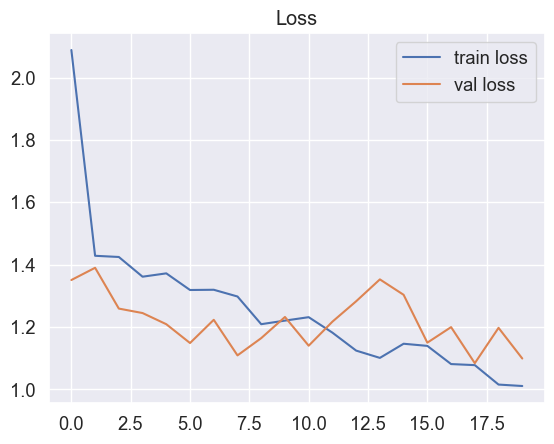

In [339]:
#학습 곡선 확인
plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.title('Accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.title('Loss')

plt.legend()
plt.show()

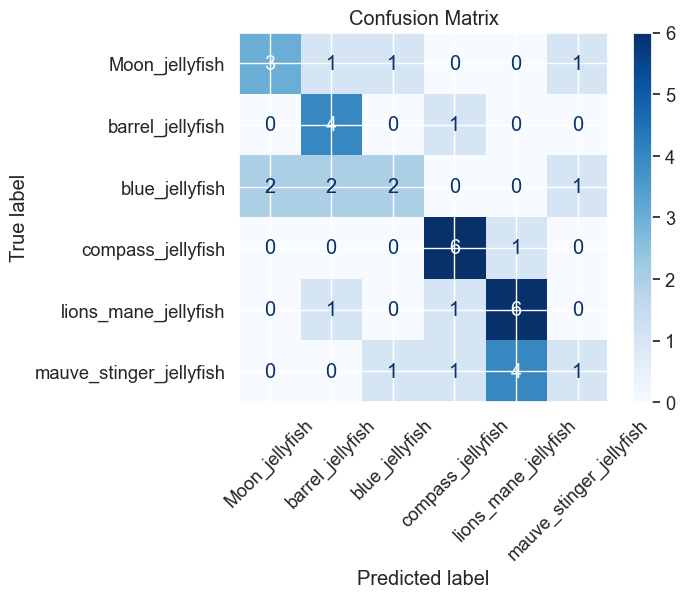

In [341]:
# Confusion Matrix 시각화

# 예측 수행
y_pred = []
y_true = []

for images, labels in test_ds:
    preds = model_cnn.predict(images, verbose=0)
    y_pred.extend(np.argmax(preds, axis=1))
    y_true.extend(labels.numpy())

# 클래스 이름 (Dataset에서 자동 인식된 순서)
class_names = test_ds.class_names

cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(xticks_rotation=45, cmap='Blues')
plt.title("Confusion Matrix")
plt.show()

**결과 확인**
- 테스트 정확도: 0.5500, 테스트 손실: 1.0828 로, 베이스라인 모델과 비교 불가할 정도로 현저히 낮은 성능.

</n>

**원인 예상**
1. **Feature Extractor의 표현력 차이**
    - MobileNetV3는 수십 개의 depthwise/separable conv를 가지고 있어 미세한 차이 감지 능력이 우수
    - 하지만 CNN은 단순 Conv2D + MaxPooling 구조로, 복잡한 패턴을 놓치기 쉬움.
2. **전처리 전략과의 상호작용**
    - 우리가 적용한 전처리 전략은 미세한 정보 차이를 더 부각시키는 작업임.
    - 하지만 CNN은 그 미세한 차이를 포착할 수 있을 정도로 정교하지 못함.

 ### 4.1.2 Mobilnet V2

**베이스 모델과 비교 포인트**   
|항목|설명|
|-|-|
|**장점**| 동일한 MobileNet 계열 구조로 비교 기준 동일하나, 더 빠르고 얕음|
|**베이스라인 대비 기대 효과**| - 구조가 더 간단해, 학습이 빠르고 **일반화 성능이 좋을 수 있음**</br>- 성능은 비슷하지만 속도 개선 가능|

In [351]:
# MobileNetV2 모델 로드 및 고정
model_mobilenetv2 = tf.keras.applications.MobileNetV2(
    input_shape=(224, 224, 3), include_top=False, weights='imagenet'
)
model_mobilenetv2.trainable = False  # 사전 학습된 가중치 고정

# 사용자 정의 분류기 추가
model_mobilenetv2 = models.Sequential([
    model_mobilenetv2,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(128, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.5),
    layers.Dense(len(class_names), activation='softmax')  # 클래스 수에 맞게 출력층 설정
])

# 모델 컴파일
model_mobilenetv2.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model_mobilenetv2.summary()

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224 (Functional)    │ (None, 7, 7, 1280)          │       2,257,984 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_13          │ (None, 1280)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_12               │ (None, 1280)                │           5,120 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_27 (Dense)                     │ (None, 128)                 │         163,968 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_13               │ (None, 128)                 │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_13 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_28 (Dense)                     │ (None, 6)                   │             774 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,428,358 (9.26 MB)

 Trainable params: 167,558 (654.52 KB)

 Non-trainable params: 2,260,800 (8.62 MB)

#### 모델 학습

In [349]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, min_lr=1e-5)
]

history = model_mobilenetv2.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=30,
    callbacks=callbacks
)

Epoch 1/30
29/29 ━━━━━━━━━━━━━━━━━━━━ 25s 596ms/step - accuracy: 0.3058 - loss: 2.3430 - val_accuracy: 0.3000 - val_loss: 1.7783 - learning_rate: 0.0010
Epoch 2/30
29/29 ━━━━━━━━━━━━━━━━━━━━ 14s 463ms/step - accuracy: 0.5881 - loss: 1.2208 - val_accuracy: 0.3875 - val_loss: 1.6431 - learning_rate: 0.0010
Epoch 3/30
29/29 ━━━━━━━━━━━━━━━━━━━━ 13s 451ms/step - accuracy: 0.6592 - loss: 0.8782 - val_accuracy: 0.4750 - val_loss: 1.6581 - learning_rate: 0.0010
Epoch 4/30
29/29 ━━━━━━━━━━━━━━━━━━━━ 13s 451ms/step - accuracy: 0.7603 - loss: 0.7020 - val_accuracy: 0.4375 - val_loss: 1.6810 - learning_rate: 0.0010
Epoch 5/30
29/29 ━━━━━━━━━━━━━━━━━━━━ 13s 448ms/step - accuracy: 0.8075 - loss: 0.5902 - val_accuracy: 0.4125 - val_loss: 1.7080 - learning_rate: 2.0000e-04
Epoch 6/30
29/29 ━━━━━━━━━━━━━━━━━━━━ 13s 446ms/step - accuracy: 0.8112 - loss: 0.5081 - val_accuracy: 0.4000 - val_loss: 1.7553 - learning_rate: 2.0000e-04
Epoch 7/30
29/29 ━━━━━━━━━━━━━━━━━━━━ 13s 442ms/step - accuracy: 0.8260 - 

#### 성능 평가

In [353]:
# 테스트 데이터 평가
test_loss, test_acc = model.evaluate(test_ds)
print(f"테스트 손실: {test_loss:.4f}")
print(f"테스트 정확도: {test_acc:.4f}")

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 272ms/step - accuracy: 0.7771 - loss: 0.5851
테스트 손실: 0.5895
테스트 정확도: 0.7750


#### 결과 시각화

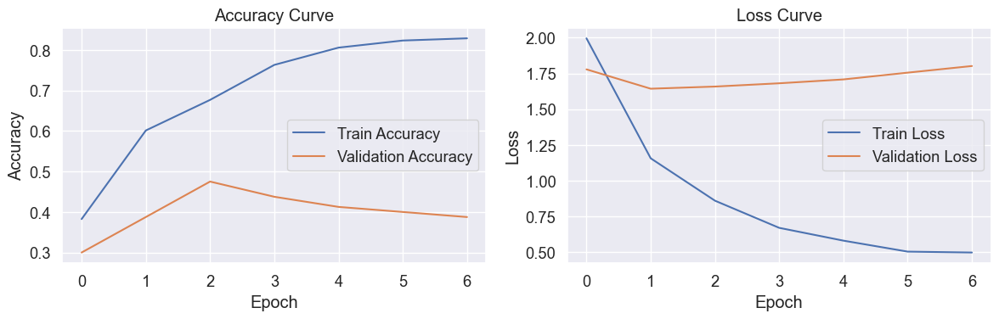

In [355]:
plt.figure(figsize=(12, 4))

# 정확도 곡선 시각화
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Curve')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# 손실 곡선 시각화
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

#### Confusion_Matrix

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


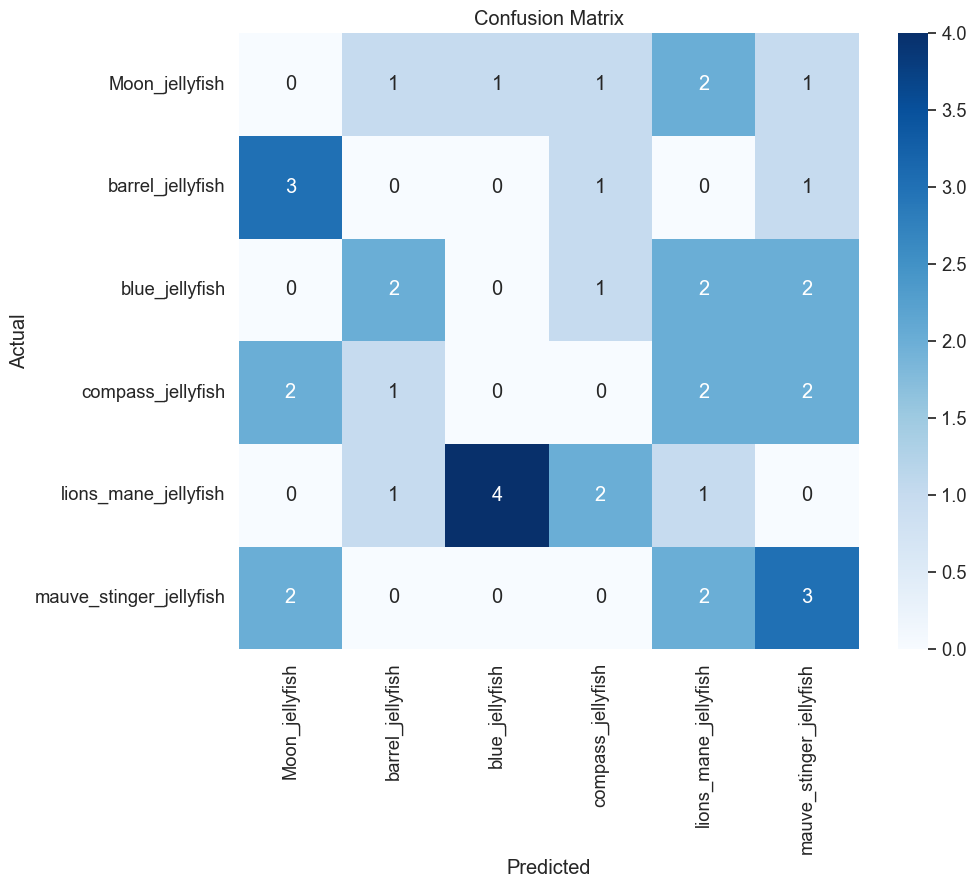

In [357]:
# 혼동 행렬 계산 및 시각화
y_pred_classes = np.concatenate([np.argmax(model.predict(x), axis=1) for x, _ in test_ds])
y_true_classes = np.concatenate([y for _, y in test_ds])

cm = confusion_matrix(y_true_classes, y_pred_classes)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

**결과 확인**
- 테스트 정확도: 0.7750, 테스트 손실: 0.5895 로, 베이스라인 모델 대비 상당히 낮은 성능.
- 2 에포크부터 떨어지는 val accuracy 확인.

</n>

**원인 예상**
1. **이른 과적합**
    - V2는 기본적으로 얕아서 feature 추출력이 부족함.
    - 하지만 우리 task 및 전처리 전략은 미세한 차이에 집중하도록 함.
    - V2는 빠르게 학습데이터에 적응하고 일반화를 하지 못해서 train은 상승하나 val은 하락함
2. **데이터 특성 및 전처리 전략과의 상호작용**
    - 해파리 데이터는 미세한 형태/색/텍스처를 보고 판단해야하며,
    - 우리가 적용한 전처리 전략은 미세한 정보 차이를 더 부각시키는 작업임.
    - 하지만 V2는 그 미세한 차이를 포착할 수 있을 정도로 깊지 못함.

### 4.1.3 ConvNext

**베이스 모델과 비교 포인트**   
|항목|설명|
|-|-|
|**장점**| - 복잡한 텍스처, 유사한 해파리 모양 등 고차원 시각 패턴 인식에 탁월 </br>-데이터 양이 적더라도 전이학습 + fine-tuning으로 높은 성능 가능|
|**베이스라인 대비 기대 효과**| - 유사 색상 / 형태 클래스에서도 **미세한 패턴 학습 가능성↑**</br>- 정교한 피쳐 추출 가능|

In [372]:
# 사전학습 모델에 맞는 전처리, 사전학습된 모델 불러오기
weights = ConvNeXt_Tiny_Weights.DEFAULT
model_convnext = convnext_tiny(weights=weights)

# 출력층만 6개 클래스로 수정
in_features = model_convnext.classifier[2].in_features  # 구버전 호환
model_convnext.classifier[2] = nn.Linear(in_features, 6)

# 가능하면 GPU 사용하고, 안될 시 CPU 사용.
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_convnext = model_convnext.to(device)

In [386]:
transform = weights.transforms()

train_data = ImageFolder(base_path / 'Train_preprocessing', transform=transform)
val_data = ImageFolder(base_path / 'valid_preprocessing', transform=transform)
test_data = ImageFolder(base_path / 'test_preprocessing', transform=transform)

train_loader = DataLoader(train_data, batch_size=32, shuffle=True)
val_loader = DataLoader(val_data, batch_size=32)
test_loader = DataLoader(test_data, batch_size=32)

class_names = train_data.classes

In [405]:
@torch.no_grad()
def evaluate(model, dataloader):
    model.eval()
    correct, total = 0, 0
    running_loss = 0.0
    criterion = nn.CrossEntropyLoss()

    for inputs, labels in dataloader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        loss = criterion(outputs, labels)

        running_loss += loss.item() * inputs.size(0)
        preds = torch.argmax(outputs, dim=1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

    avg_loss = running_loss / total
    acc = correct / total
    return acc, avg_loss

In [394]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model_convnext.parameters(), lr=1e-4)

train_acc_list = []
val_acc_list = []
train_loss_list = []
best_val_acc = 0.0
best_model_path = "best_model.pth"

for epoch in range(20):
    model_convnext.train()
    running_loss, correct, total = 0.0, 0, 0

    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model_convnext(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * inputs.size(0)
        preds = torch.argmax(outputs, dim=1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

    train_loss = running_loss / total
    train_acc = correct / total
    val_acc = evaluate(model_convnext, val_loader)

    train_acc_list.append(train_acc)
    val_acc_list.append(val_acc)
    train_loss_list.append(train_loss)

    print(f"Epoch {epoch+1}: Train Acc = {train_acc:.4f}, Val Acc = {val_acc:.4f}")

    if val_acc > best_val_acc:
        best_val_acc = val_acc
        torch.save(model_convnext.state_dict(), best_model_path)
        print("🔥 Best model saved!")

Epoch 1: Train Acc = 0.9475, Val Acc = 0.8462
🔥 Best model saved!
Epoch 2: Train Acc = 0.9978, Val Acc = 0.8718
🔥 Best model saved!
Epoch 3: Train Acc = 0.9978, Val Acc = 0.8718
Epoch 4: Train Acc = 1.0000, Val Acc = 0.7949
Epoch 5: Train Acc = 1.0000, Val Acc = 0.7949
Epoch 6: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 7: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 8: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 9: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 10: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 11: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 12: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 13: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 14: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 15: Train Acc = 1.0000, Val Acc = 0.7949
Epoch 16: Train Acc = 1.0000, Val Acc = 0.7949
Epoch 17: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 18: Train Acc = 1.0000, Val Acc = 0.8205
Epoch 19: Train Acc = 1.0000, Val Acc = 0.7949
Epoch 20: Train Acc = 1.0000, Val Acc = 0.7949


In [397]:
# 학습 끝난 뒤 최고 성능 모델 불러오기
model_convnext.load_state_dict(torch.load(best_model_path))
model_convnext.eval()

C:\Users\kimho\AppData\Local\Temp\ipykernel_169092\422647411.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_convnext.load_state_dict(torch.load(best_model_path))


ConvNeXt(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
      (1): LayerNorm2d((96,), eps=1e-06, elementwise_affine=True)
    )
    (1): Sequential(
      (0): CNBlock(
        (block): Sequential(
          (0): Conv2d(96, 96, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=96)
          (1): Permute()
          (2): LayerNorm((96,), eps=1e-06, elementwise_affine=True)
          (3): Linear(in_features=96, out_features=384, bias=True)
          (4): GELU(approximate='none')
          (5): Linear(in_features=384, out_features=96, bias=True)
          (6): Permute()
        )
        (stochastic_depth): StochasticDepth(p=0.0, mode=row)
      )
      (1): CNBlock(
        (block): Sequential(
          (0): Conv2d(96, 96, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=96)
          (1): Permute()
          (2): LayerNorm((96,), eps=1e-06, elementwise_affine=True)
          (3): Linear(in_features=

In [407]:
#테스트셋 평가
test_acc, test_loss = evaluate(model_convnext, test_loader)
print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

Test Accuracy: 0.9750
Test Loss: 0.2209


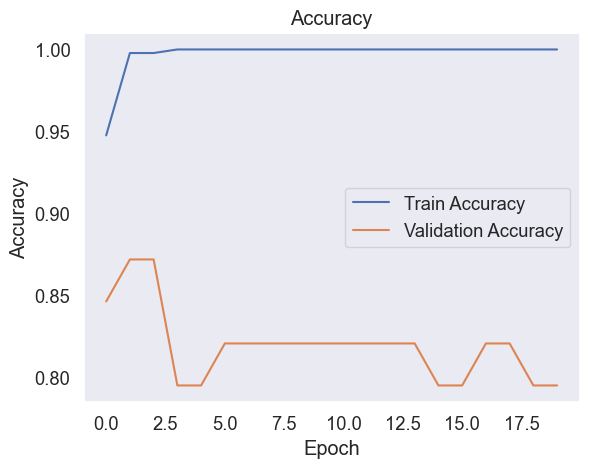

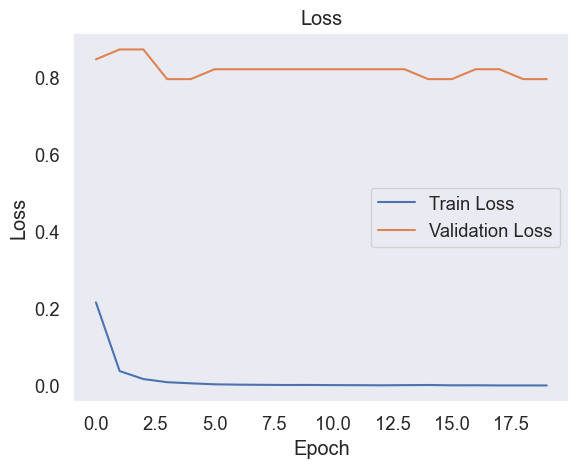

In [403]:
# 정확도 그래프
plt.plot(train_acc_list, label='Train Accuracy')
plt.plot(val_acc_list, label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

# 손실 그래프
plt.plot(train_loss_list, label='Train Loss')
plt.plot(val_acc_list, label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

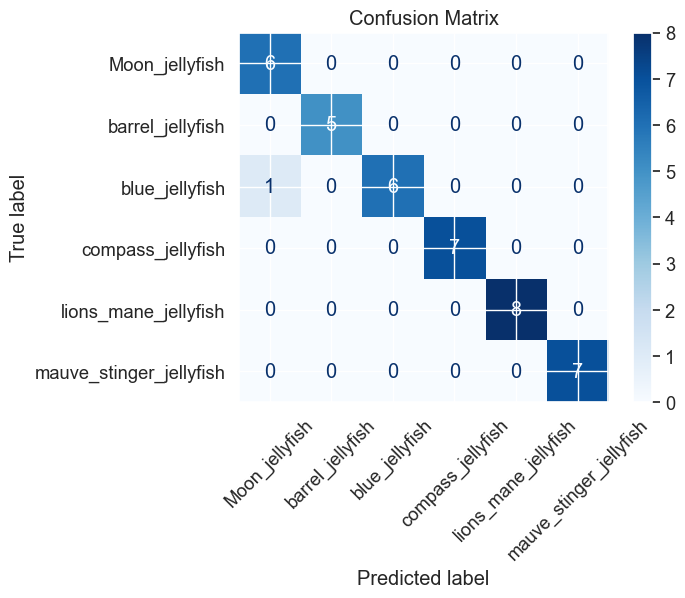

In [411]:
# 테스트셋 confusion matrix
y_pred, y_true = [], []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs = inputs.to(device)
        outputs = model_convnext(inputs)
        preds = torch.argmax(outputs, dim=1)
        y_pred.extend(preds.cpu().numpy())
        y_true.extend(labels.numpy())

# 혼동 행렬 시각화
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(xticks_rotation=45, cmap='Blues')
plt.title("Confusion Matrix")
plt.show()

**결과 확인**
- 테스트 정확도: 0.9750, 테스트 손실: 0.2209 로, blue <-> moon 1개를 제외하고는 전부 정답.
- Train Accuracy
    - 거의 2 epoch 이후부터 1.0에 수렴 → 학습 데이터는 거의 완벽하게 암기
    - Loss도 빠르게 0에 수렴, 오차 거의 없음
- Validation Accuracy
    - 초기 상승 후 급락 → 이후 0.79~0.85 수준에서 수렴
    - Validation Loss도 거의 평평하게 유지됨   
👉 과적합 예상됨.   
👉 **유일한 오답을 내었던 blue-moon 의 데이터셋을 증강한다면 정확도 100%의 가능성 있음**

### 4.1.4 ResNet50

**베이스 모델과 비교 포인트**   
|항목|설명|
|-|-|
|**장점**| 깊은 네트워크로 **복잡한 패턴 학습 가능**|
|**베이스라인 대비 기대 효과**| - 형태가 비슷하지만 차이가 미묘한 경우 → 깊은 네트워크가 **차이 포착 가능성** 높음|

In [421]:
# 🔧 기본 세팅
weights = ResNet50_Weights.DEFAULT
transform = weights.transforms()

num_classes = len(class_names)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"🖥️ Using device: {device}")

🖥️ Using device: cuda


In [423]:
# Pretrained ResNet50 불러오기
model_resnet = models.resnet50(weights=weights)
model_resnet.fc = nn.Linear(model_resnet.fc.in_features, num_classes)
model_resnet = model_resnet.to(device)

# 손실 함수 및 옵티마이저
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model_resnet.parameters(), lr=1e-4)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to C:\Users\kimho/.cache\torch\hub\checkpoints\resnet50-11ad3fa6.pth
100%|███████████████████████████████████████████████████████████████████████████████████| 97.8M/97.8M [00:01<00:00, 57.3MB/s]


In [425]:
num_epochs = 20
best_val_acc = 0.0
best_model_path = "best_resnet50.pth"

train_acc_list, val_acc_list = [], []
train_loss_list, val_loss_list = [], []

for epoch in range(num_epochs):
    model_resnet.train()
    running_loss, correct, total = 0.0, 0, 0

    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model_resnet(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * inputs.size(0)
        preds = torch.argmax(outputs, dim=1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

    train_loss = running_loss / total
    train_acc = correct / total
    val_acc, val_loss = evaluate(model_resnet, val_loader)

    train_acc_list.append(train_acc)
    val_acc_list.append(val_acc)
    train_loss_list.append(train_loss)
    val_loss_list.append(val_loss)

    print(f"📢 Epoch {epoch+1}/{num_epochs} | Train Acc: {train_acc:.4f}, Val Acc: {val_acc:.4f}")

    if val_acc > best_val_acc:
        best_val_acc = val_acc
        torch.save(model_resnet.state_dict(), best_model_path)
        print("✅ Best model saved!")

📢 Epoch 1/20 | Train Acc: 0.5749, Val Acc: 0.6154
✅ Best model saved!
📢 Epoch 2/20 | Train Acc: 0.9301, Val Acc: 0.6667
✅ Best model saved!
📢 Epoch 3/20 | Train Acc: 0.9770, Val Acc: 0.6923
✅ Best model saved!
📢 Epoch 4/20 | Train Acc: 0.9956, Val Acc: 0.6923
📢 Epoch 5/20 | Train Acc: 0.9934, Val Acc: 0.7179
✅ Best model saved!
📢 Epoch 6/20 | Train Acc: 0.9945, Val Acc: 0.6923
📢 Epoch 7/20 | Train Acc: 0.9967, Val Acc: 0.7692
✅ Best model saved!
📢 Epoch 8/20 | Train Acc: 1.0000, Val Acc: 0.7436
📢 Epoch 9/20 | Train Acc: 0.9978, Val Acc: 0.7179
📢 Epoch 10/20 | Train Acc: 0.9967, Val Acc: 0.6667
📢 Epoch 11/20 | Train Acc: 0.9989, Val Acc: 0.7436
📢 Epoch 12/20 | Train Acc: 0.9978, Val Acc: 0.7179
📢 Epoch 13/20 | Train Acc: 1.0000, Val Acc: 0.7436
📢 Epoch 14/20 | Train Acc: 1.0000, Val Acc: 0.7949
✅ Best model saved!
📢 Epoch 15/20 | Train Acc: 0.9989, Val Acc: 0.6923
📢 Epoch 16/20 | Train Acc: 0.9945, Val Acc: 0.7179
📢 Epoch 17/20 | Train Acc: 0.9945, Val Acc: 0.7949
📢 Epoch 18/20 | Train 

In [427]:
# 학습 끝난 뒤 최고 성능 모델 불러오기
model_resnet.load_state_dict(torch.load(best_model_path))
model_resnet.eval()

C:\Users\kimho\AppData\Local\Temp\ipykernel_169092\1775628045.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_resnet.load_state_dict(torch.load(best_model_path))


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [429]:
#테스트셋 평가
test_acc, test_loss = evaluate(model_resnet, test_loader)
print(f"Test Accuracy: {test_acc:.4f}")
print(f"Test Loss: {test_loss:.4f}")

Test Accuracy: 0.9000
Test Loss: 0.4557


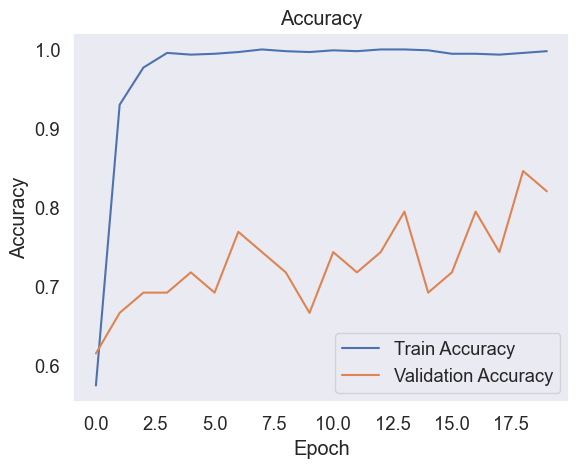

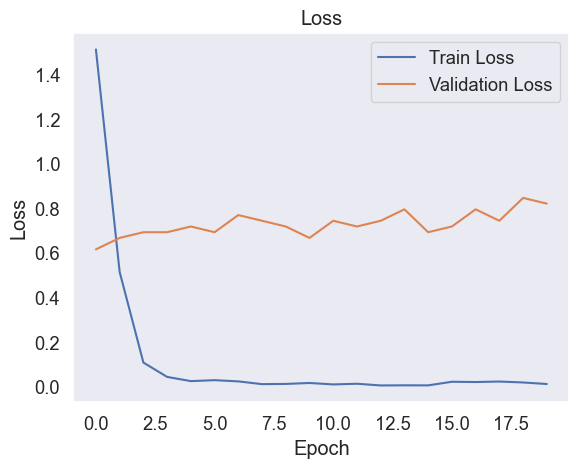

In [431]:
# 정확도 그래프
plt.plot(train_acc_list, label='Train Accuracy')
plt.plot(val_acc_list, label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

# 손실 그래프
plt.plot(train_loss_list, label='Train Loss')
plt.plot(val_acc_list, label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

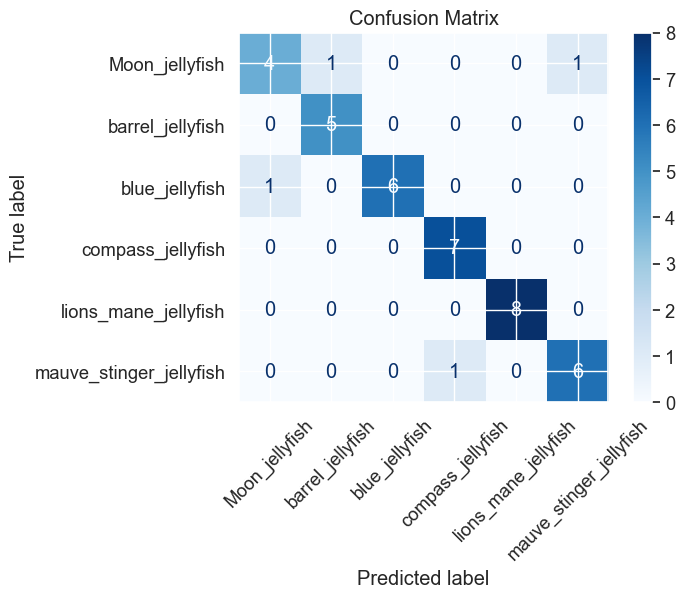

In [433]:
# 테스트셋 confusion matrix
y_pred, y_true = [], []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs = inputs.to(device)
        outputs = model_resnet(inputs)
        preds = torch.argmax(outputs, dim=1)
        y_pred.extend(preds.cpu().numpy())
        y_true.extend(labels.numpy())

# 혼동 행렬 시각화
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(xticks_rotation=45, cmap='Blues')
plt.title("Confusion Matrix")
plt.show()

**결과 확인**
- 테스트 정확도: 0.9000, 테스트 손실: 0.4557 로, 준수한 성능 확인.
- Train Accuracy
    - 거의 완벽하게 1.0에 수렴 → 과적합 가능성 있
- Validation Accuracy
    - 초반 빠르게 상승 후 불안정한 패턴
    - epoch 증가에도 성능이 일정 이상 향상되지 않음 → 학습이 일반화되지 않았음
    - 3~5 에포크부터 과적합 의심
- 혼동되는 패턴이 Moon, Blue, Mauve 계열에서 주로 발생
👉 과적합 예상됨.   
👉 **데이터셋을 증강한다면 정확도 100%의 가능성 있음**

### 4.2 4가지 모델 결론

- 가장 준수한 성능을 보였던 ConvNext 및 Resnet50 모두 데이터셋 증강을 통해 정확도 향상의 여지가 있음을 확인함

**[ConvNeXt가 1위를 차지한 이유]**
1. 현대적 구조로 개선된 CNN
   - ConvNeXt는 ResNet을 기반으로 하지만, Transformer의 설계를 차용해 성능을 높인 최신 CNN
   - 커널 사이즈 확장(7x7), 더 깊은 레이어, LayerNorm 등의 도입으로 전통적인 CNN의 한계를 극복함

</n>

2. 더 깊고 넓은 구조
    - 더 많은 파라미터와 깊이로 인해 복잡한 패턴도 더 잘 학습
    - 이는 해파리 이미지처럼 종 간 경계가 모호한 데이터에서 높은 분류력을 발휘하는 데 유리

</n>

3. 효율적인 downsampling 및 normalization
    - 전처리된 이미지의 특성을 잘 반영할 수 있는 구조임.
    - 데이터 전처리(예: 정규화, 리사이징)가 잘 되어 있을수록 ConvNeXt의 성능이 더 극대화

</n>
</n>


**[ResNet50이 2위를 차지한 이유]**
1. 잔차 연결(Residual Connection)로 안정적인 학습
    - ResNet50은 딥러닝 학습에서 발생하는 gradient vanishing 문제를 해결
    - 깊은 네트워크 구조에서도 안정적으로 학습 가능

</n>

2. 표준 모델로서의 높은 일반화 성능
    - 다양한 이미지 분류 태스크에서 널리 검증된 모델
    - EDA와 전처리가 잘 이루어진 데이터셋에서 기본적인 성능이 뛰어남

</n>

3. 다소 간결한 구조로 과적합 가능성 낮음
    - ConvNeXt보다 파라미터 수는 적지만, 중복 특성 학습을 줄이고 빠르게 수렴하는 특성
    - 데이터가 많지 않거나 noise가 있는 경우 상대적으로 안정적인 결과를 낼 수 있음

# 5. 결론

**[최종 결론]**   
본 프로젝트는 해파리 이미지 데이터를 기반으로 종 분류 모델을 개발하는 것을 목표로 하였습니다.    
다양한 CNN 기반 모델을 실험한 결과, ConvNeXt와 ResNet50이 각각 1위, 2위의 높은 정확도를 기록하였습니다.   

ConvNeXt는 최신 구조의 CNN으로, 넓은 커널 사이즈, 향상된 normalization 기법, 깊은 네트워크 설계를 통해 복잡한 시각적 패턴을 효과적으로 학습하였습니다.   
전처리와 EDA를 통해 데이터 품질을 높인 점이 모델 성능 향상에 핵심적인 역할을 했습니다.   
ResNet50은 잔차 연결 구조를 활용한 안정적인 학습 능력과 범용성이 강점이었으며, 데이터에 대한 일반화 성능이 뛰어났습니다.   

프로젝트 수행 과정에서 EDA 및 전처리의 중요성이 명확히 드러났으며,   
데이터 불균형, 클래스 간 유사도, 이미지 품질 편차 등이 분류 성능에 직접적인 영향을 미치는 주요 요인임을 확인했습니다.   


**[한계 및 향후 방향]**
- 일부 클래스에 대한 데이터 수 부족 및 이미지 품질 편차는 여전히 성능 저하 요인으로 작용함
- 향후 이미지 증강 적용을 통해 분류 정확도를 더욱 향상시킬 수 있음